# Final Project: Radio Group
# Index
These lab sections roughly correspond with sections in the formal lab writeup:
0. [Imports](#imports)
1. [Obtaining Data](#obdata)
1. [Plotting Data](#pldata)
1. [Measuring Velocities](#spec1)
 * [Spectrum 1](#spec1)
 * [Spectrum 2](#spec2)
 * [Spectrum 3](#spec3)
 * [Spectrum 4](#spec4)
 * [Spectrum 5](#spec5)
 * [Spectrum 6](#spec6)
 * [Spectrum 7](#spec7)
1. [Galactic Location](#galloc)
1. [LOS Velocities](#los)
 * [Topocentric](#los)
 * [Barycentry](#bary)
 * [LSR](#lsr)
1. [Fitted Velocities v. Galactic Radii](#fitted)
1. [Predicted Mass](#mass)
1. [Tables](#tables)

Due to how many images there are, it is recommended that you click back up to the index when you reach "Plotting Data" and then click to "Measuring Velocities".

<a id="imports"></a>
## Imports
[Index](#Index)

In [1]:
import numpy as np
from astropy import units as u, constants
from astropy.modeling.models import Linear1D
from astropy.modeling.models import Gaussian1D
from astropy.modeling.polynomial import Polynomial1D
from astropy import visualization
from astropy.modeling.fitting import LevMarLSQFitter
from astropy.modeling.fitting import LinearLSQFitter
fitter = LevMarLSQFitter()
lnfitter = LinearLSQFitter()

import os
import glob
from astropy.io import fits
from astropy.wcs import WCS
from astropy.utils.data import get_pkg_data_filename
from astropy.visualization.wcsaxes.frame import EllipticalFrame
from astropy.visualization import simple_norm

from astroplan import Observer
from astropy import units as u, coordinates
from astropy.table import Table
from astropy.io import ascii
import datetime
import pytz
tz = pytz.timezone('US/Eastern')

%matplotlib inline
import pylab as pl
pl.rcParams['image.origin'] = 'lower'
#pl.style.use('dark_background')
visualization.quantity_support()


>>> from astroplan import download_IERS_A
>>> download_IERS_A()
 [astroplan.utils]


<astropy.visualization.units.quantity_support.<locals>.MplQuantityConverter at 0x20083513f88>

<a id="obdata"></a>
## Obtaining Data
[Index](#Index)

From the READMEs and discussions, we know that Nina and Johnathan's data are both unrecoverable for functional purposes. 

In [2]:
def listfiles(folder, matchstr='readme'):
    """ Find all files with the matchstr (readme) in their name, case-insensitively """
    for root, folders, files in os.walk(folder):
        for filename in folders + files:
            if matchstr in filename.lower():
                yield os.path.join(root, filename)
readmes = list(listfiles('.', matchstr='readme'))

for readme in readmes:
    with open(readme, 'r') as fh:
        print('===========================')
        print(readme)
        print('---------------------------')
        print(fh.read())

.\final_data\ashneil\nash\README.txt
---------------------------
Neil Ash
9/20/2020
1010 files, with 1000 data 
observation files are labelled with *tint60s_sdr0_fsw9_20_drift_60s.fits
data size: 115 MB

Observation log name: Observation log

Times listed in the files are offset by some amount, as the laptop used for
observations did not have the correct time listed. This time is corrected
by subtracting the offset:

Offset = TimeDelta(0.299525462962963,scale='tai', format='jd')

from all the times listed by the files. 


.\final_data\bashaoketa\README.md
---------------------------
Observing Data

Name: Oketa Basha
Observing date: Sep. 27, 2020
Submission date: Oct. 16, 2020
Number of files: 27x fits files, 1x exel sheet, 1xpdf, 1x README
Size of the files: 3213 KB (for all the fits files), 119KB per fits file, in total with the write up and obserbiving log = 5.36 MB
Notes about what might have gone wrong: It took me couple minutes to debug the code used to get the data so the angles 

In [3]:
#I manually took out a bunch of bad data so my files look different
files_ash = glob.glob(".\\final_data\\ashneil\\nash\\9_20_drift\\*fits")
nfiles_ash = len(files_ash)

files_oketa = glob.glob(".\\final_data\\bashaoketa\\science\\*fits")
nfiles_oketa = len(files_oketa)

files_nina = glob.glob(".\\final_data\\brownnina\\9_26\\fits_files\\science\\*fits")
nfiles_nina = len(files_nina)

files_aden = glob.glob(".\\final_data\\dawsonaden\\Aden Dawson Radio Project Data Folder\\Science Data\\*fits")
nfiles_aden = len(files_aden)

files_michael = glob.glob(".\\final_data\\feromichael\\Radio Lab\\new_data\\drift_scan\\*fits")
nfiles_michael = len(files_michael)

files_madeline = glob.glob(".\\final_data\\hallmadeline\\MadelineHall (2)\\MadelineHall_Data\\*fits")
nfiles_madeline = len(files_madeline)

files_jacob = glob.glob(".\\final_data\\plummerjacob\\The_Package\\Data\\*fits")
nfiles_jacob = len(files_jacob)

files_jillian = glob.glob(".\\final_data\\richardsonjillian\\Jillian Richardson Radio Astronomy Lab\\science\\*fits")
nfiles_jillian = len(files_jillian)

files_john = glob.glob(".\\final_data\\robertsjonathan\\User_data\\oberving\\*\*fits")
nfiles_john = len(files_john)

files_bethany = glob.glob(".\\final_data\\ryderbethany\\Ryder 10-01-20 radio data\\science_fits\\*fits")
nfiles_bethany = len(files_bethany)

files_reid = glob.glob(".\\final_data\\scarpinatoreid\\*fits")
nfiles_reid = len(files_reid)

files_hannah = glob.glob(".\\final_data\\sparkeshannah\\radio_astro_data\\science\\*fits")
nfiles_hannah = len(files_nina)

files_patrick = glob.glob(".\\final_data\\sullivanpatrick\\RadioLab_PatrickSullivan\\Patrick Sullivan with Science Files\\all science files\\*fits")
nfiles_patrick = len(files_patrick)

files_katie = glob.glob(".\\final_data\\teixeirakatie\\Katie Teixeira-Radio Astronomy Lab\\science\\*fits")
nfiles_katie = len(files_katie)

files = [*files_ash, *files_oketa, *files_nina, *files_aden, *files_michael, *files_madeline, *files_jacob,
        *files_jillian, *files_john, *files_bethany, *files_reid, *files_hannah, *files_patrick, *files_katie]

In [4]:
#gathering the metadata
metadata_list = []
for fn in sorted(files):
    tblmeta = Table.read(fn).meta
    tblmeta['filename'] = fn
    metadata_list.append(tblmeta)
metadata_table = Table(metadata_list)

#getting rid of the bad data I missed
tbl = metadata_table
on_sky = ((tbl['--altitude'] != '-999') &
          (tbl['--altitude'] != '--') &
          (tbl['--altitude'] != 'N/A'))

#driftscan data. I thought I was going to need this but I ended up not needing it.
drifts = np.array([('drift' in row['SUFFIX']) or
                   ('drift' in row['filename']) or
                   ('Sullivan' in row['filename']) for row in metadata_table])

#metadata getting rid of johnathan's bad data 
metadata_table_onsky = metadata_table[on_sky].copy()
jonathan = np.array(['robertsjonathan' in name for name in metadata_table_onsky['filename']], dtype='bool')
metadata_table_onsky = metadata_table_onsky[~jonathan]
bethany = np.array(['ryderbethany' in name for name in metadata_table_onsky['filename']], dtype='bool')
metadata_table_onsky = metadata_table_onsky[~bethany]

#fixing time stamps
late_timestamps = ('feromichael', 'brownnina', 'ashneil')
for ii,row in enumerate(metadata_table_onsky):
    if any(x in row['filename'] for x in late_timestamps):
        dateobs = datetime.datetime.strptime(row['DATE-OBS'], "%y%m%d_%H%M%S")
        dateobs += datetime.timedelta(hours=3)
        newdate = datetime.datetime.strftime(dateobs, "%y%m%d_%H%M%S")
        row['DATE-OBS'] = newdate

In [5]:
glons = []
glats = []
rvcorrs = []
skycoor = []

#making the metadata more user friendly
for row in metadata_table_onsky:
    obslon = float(row['--obs_lon']) * u.deg
    obslat = float(row['--obs_lat']) * u.deg
    location = coordinates.EarthLocation.from_geodetic(obslon, obslat, 100*u.m)
    observer = Observer(location, timezone='US/Eastern')

    obs_time_notz = datetime.datetime.strptime(row['DATE-OBS'], "%y%m%d_%H%M%S")
    
    obs_time = tz.localize(obs_time_notz)
      
    alt = float(row['--altitude'])
    az = float(row['--azimuth'])
    target_altaz = coordinates.AltAz(alt=alt*u.deg,
                                     az=az*u.deg,
                                     location=observer.location,
                                     obstime=obs_time)
    target_galactic = target_altaz.transform_to(coordinates.Galactic)
    
    skycoord = coordinates.SkyCoord(target_altaz)
    skycoor.append(skycoord)
    rvcorrs.append(skycoord.radial_velocity_correction())
    
    glons.append(target_galactic.l)
    glats.append(target_galactic.b)
metadata_table_onsky.add_column(u.Quantity(glons), name='glon')
metadata_table_onsky.add_column(u.Quantity(glats), name='glat')
metadata_table_onsky.add_column(u.Quantity(rvcorrs), name='rvcorr')
metadata_table_onsky.add_column(skycoor, name='sky')

In [6]:
onplane = (np.abs(metadata_table_onsky['glat']) < 5) & ((metadata_table_onsky['glon']<90) | (metadata_table_onsky['glon']>270))

In [7]:
#looking through the galactic plane data to find good spectra
useable_data = metadata_table_onsky[onplane]
group1 = [Table.read(useable_data[ii]['filename']) for ii in range(10)]
group2 = [Table.read(useable_data[ii]['filename']) for ii in range(10,20)]
group3 = [Table.read(useable_data[ii]['filename']) for ii in range(20,30)]
group4 = [Table.read(useable_data[ii]['filename']) for ii in range(30,40)]
group5 = [Table.read(useable_data[ii]['filename']) for ii in range(40,50)]
group6 = [Table.read(useable_data[ii]['filename']) for ii in range(50,60)]
group7 = [Table.read(useable_data[ii]['filename']) for ii in range(60,70)]
group8 = [Table.read(useable_data[ii]['filename']) for ii in range(70,80)]
group9 = [Table.read(useable_data[ii]['filename']) for ii in range(80,90)]
group10 = [Table.read(useable_data[ii]['filename']) for ii in range(90,100)]
group11 = [Table.read(useable_data[ii]['filename']) for ii in range(100,110)]
group12 = [Table.read(useable_data[ii]['filename']) for ii in range(110,120)]
group13 = [Table.read(useable_data[ii]['filename']) for ii in range(120,130)]
group14 = [Table.read(useable_data[ii]['filename']) for ii in range(130,138)]
new_data = Table.read('.\\final_data\\sparkeshannah\\radio_astro_data\\science\\psd_200924_231413_tint60s_sdr0_fswscience_63_1.fits')
group14.append(new_data)

<a id="pldata"></a>
## Plotting Data
[Index](#Index)

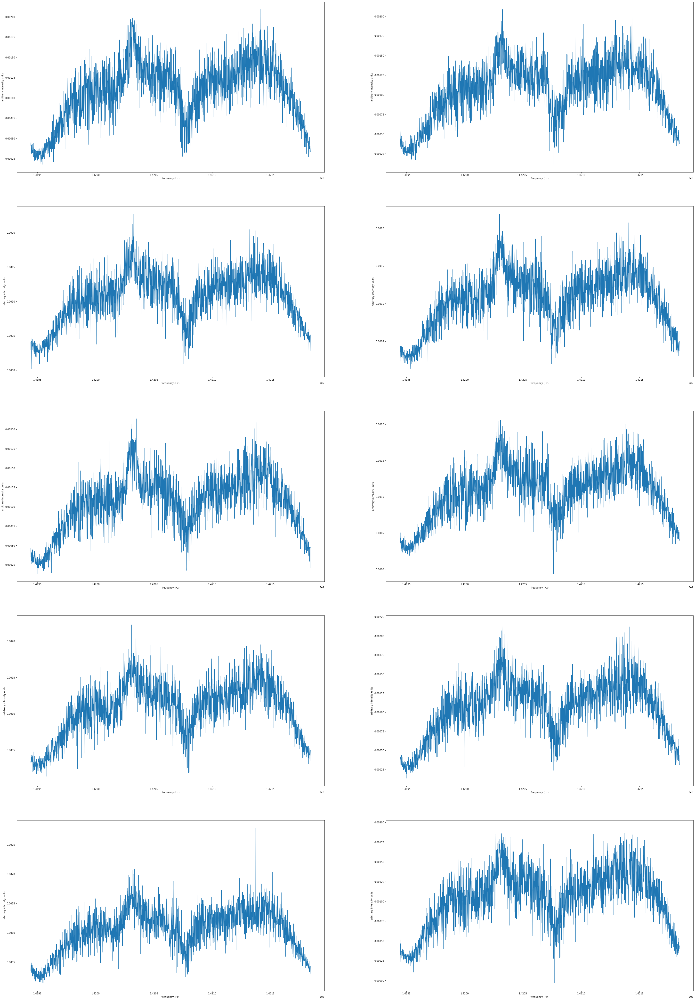

In [8]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group1[ii]['freq1'], group1[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

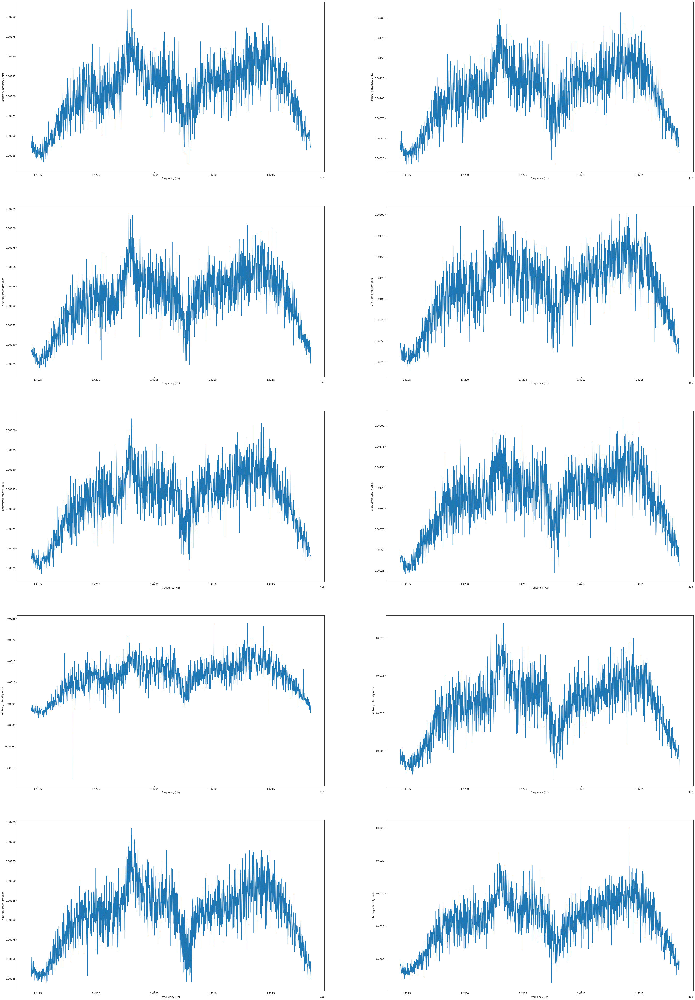

In [9]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group2[ii]['freq1'], group2[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

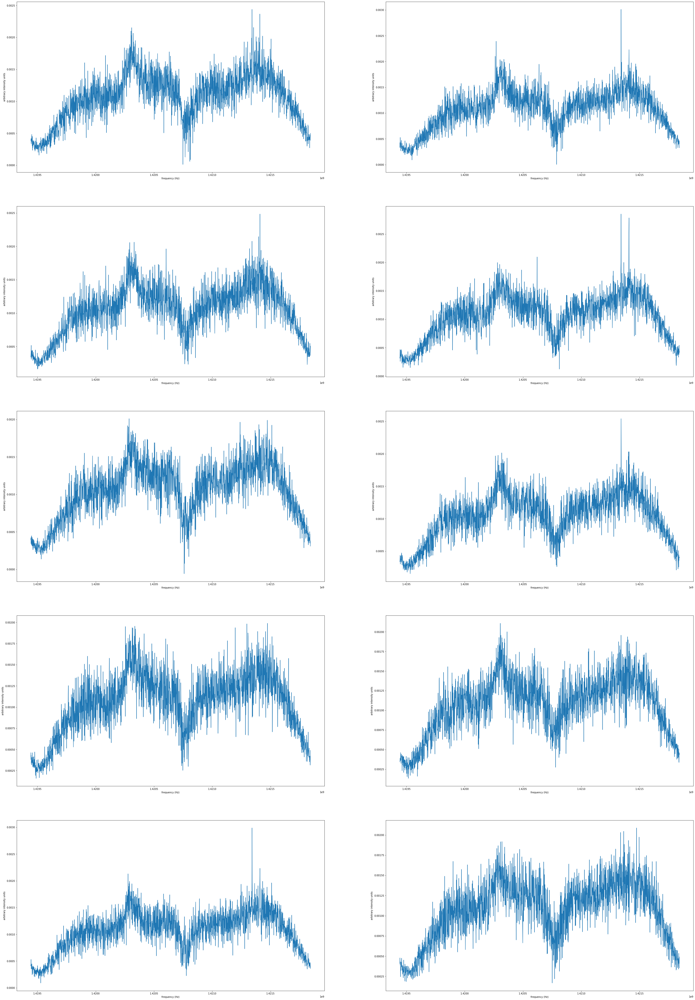

In [10]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group3[ii]['freq1'], group3[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

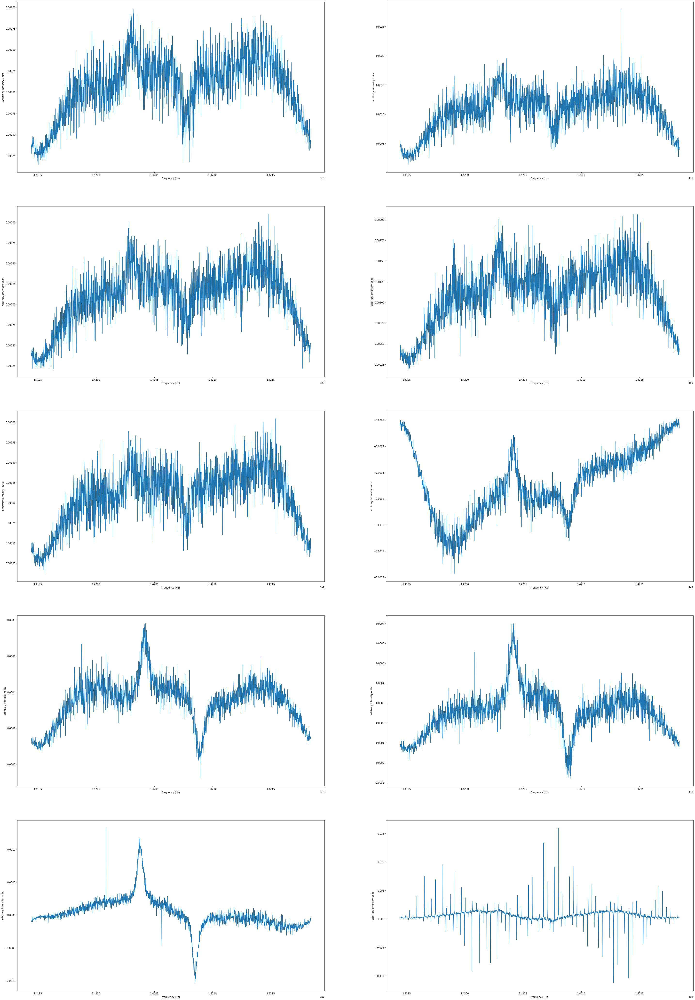

In [11]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group4[ii]['freq1'], group4[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

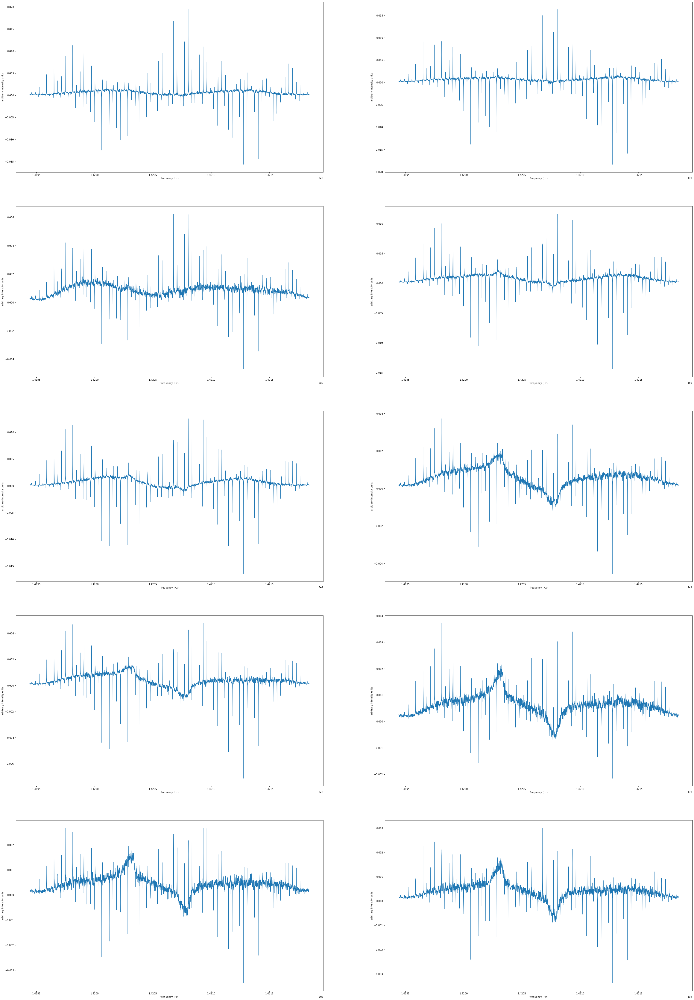

In [12]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group5[ii]['freq1'], group5[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

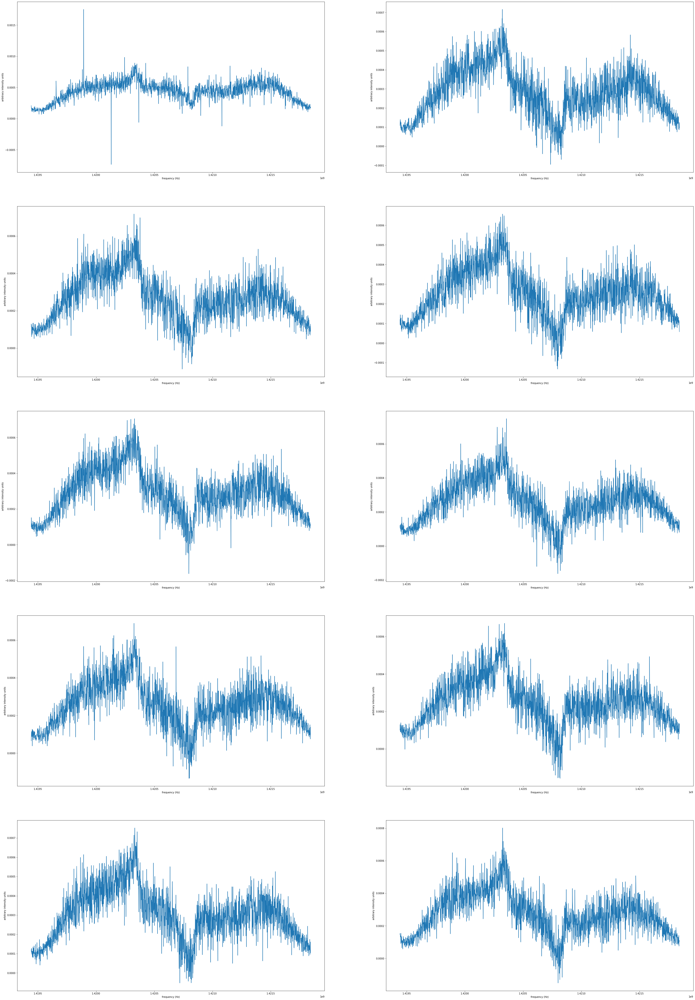

In [13]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group6[ii]['freq1'], group6[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

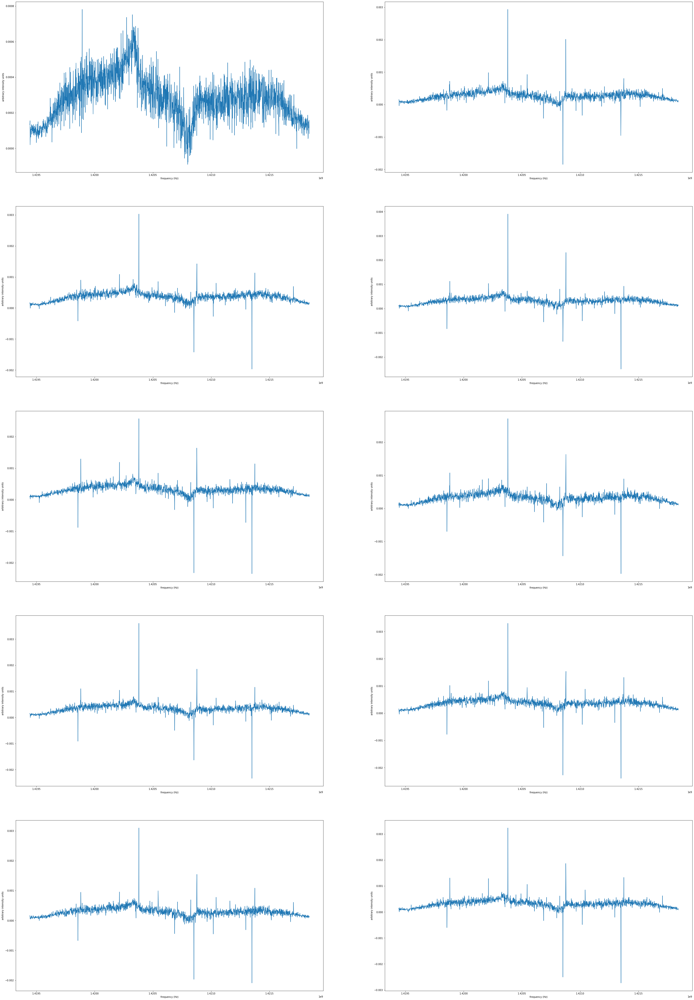

In [14]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group7[ii]['freq1'], group7[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

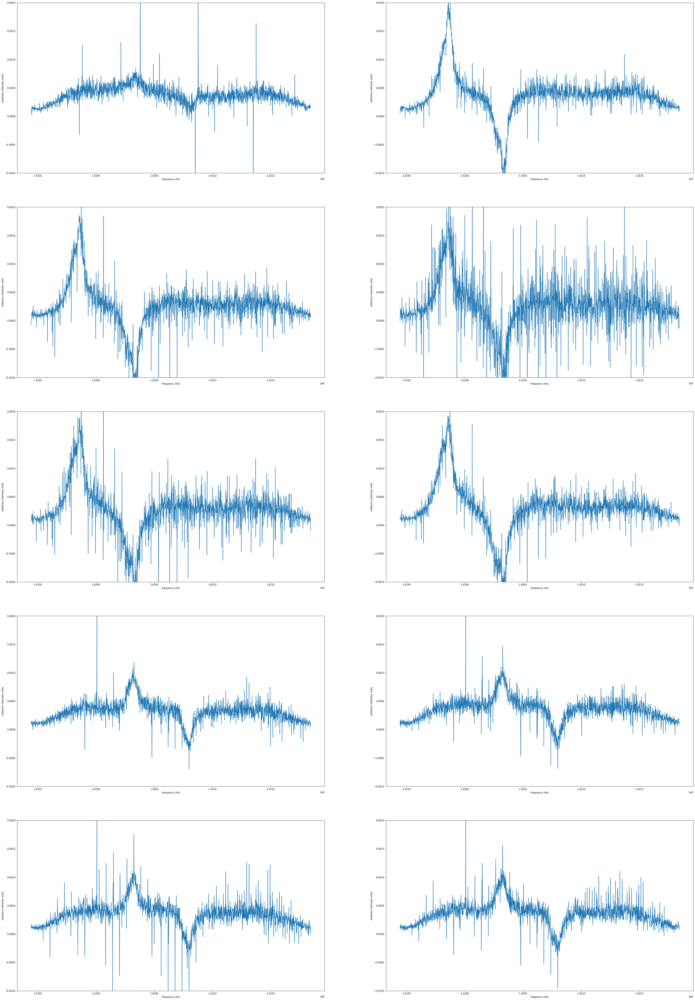

In [15]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group8[ii]['freq1'], group8[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')
    pl.ylim(-0.001, 0.002)

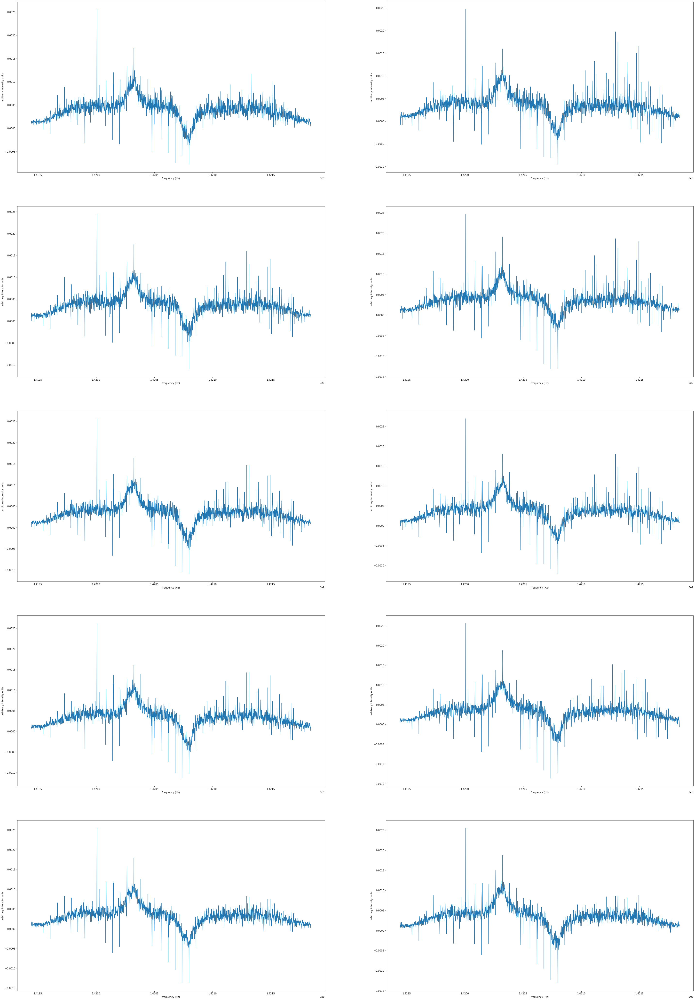

In [16]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group9[ii]['freq1'], group9[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

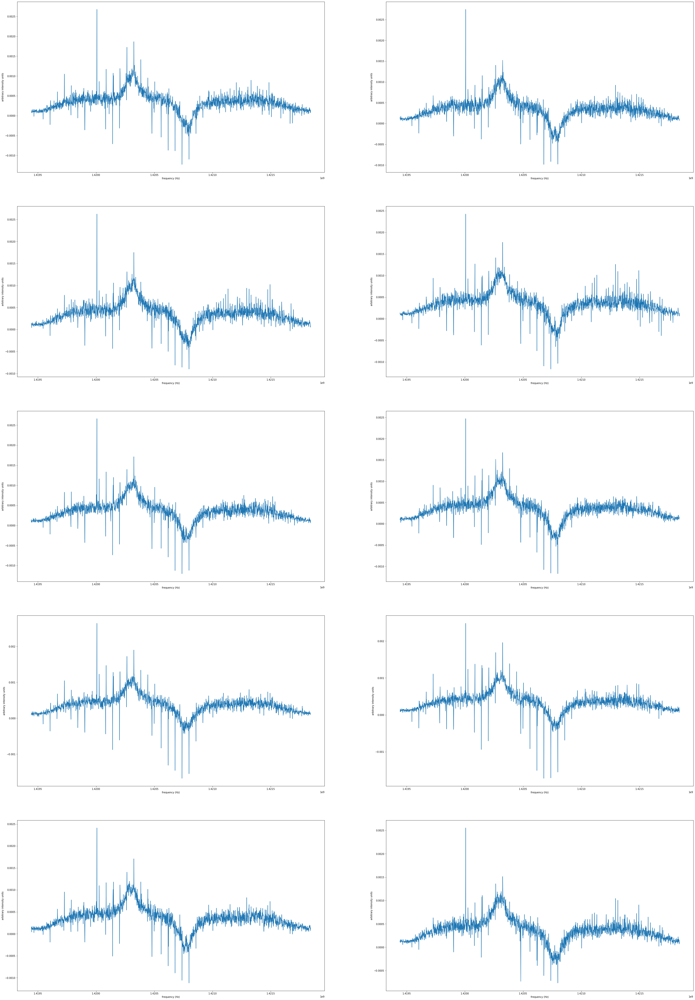

In [17]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group10[ii]['freq1'], group10[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

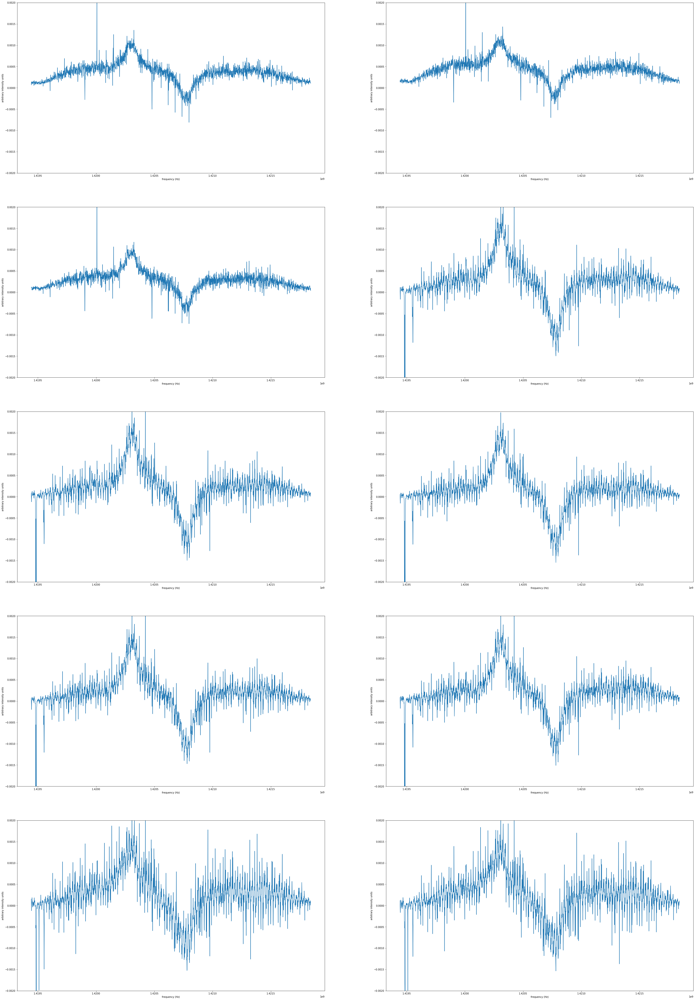

In [18]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group11[ii]['freq1'], group11[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')
    pl.ylim(-0.002, 0.002)

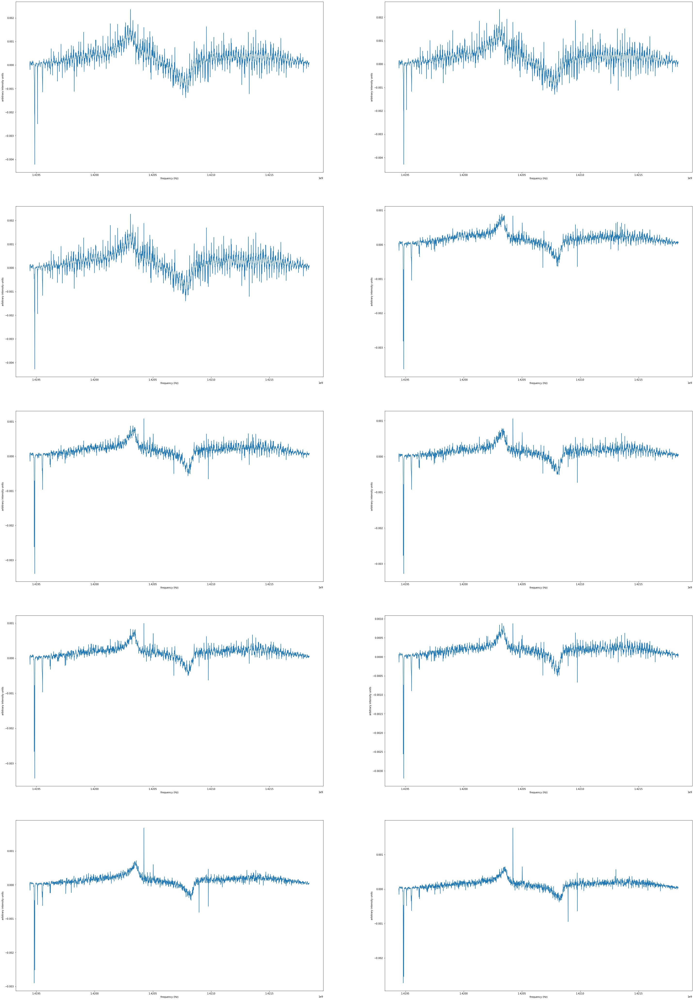

In [19]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group12[ii]['freq1'], group12[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')

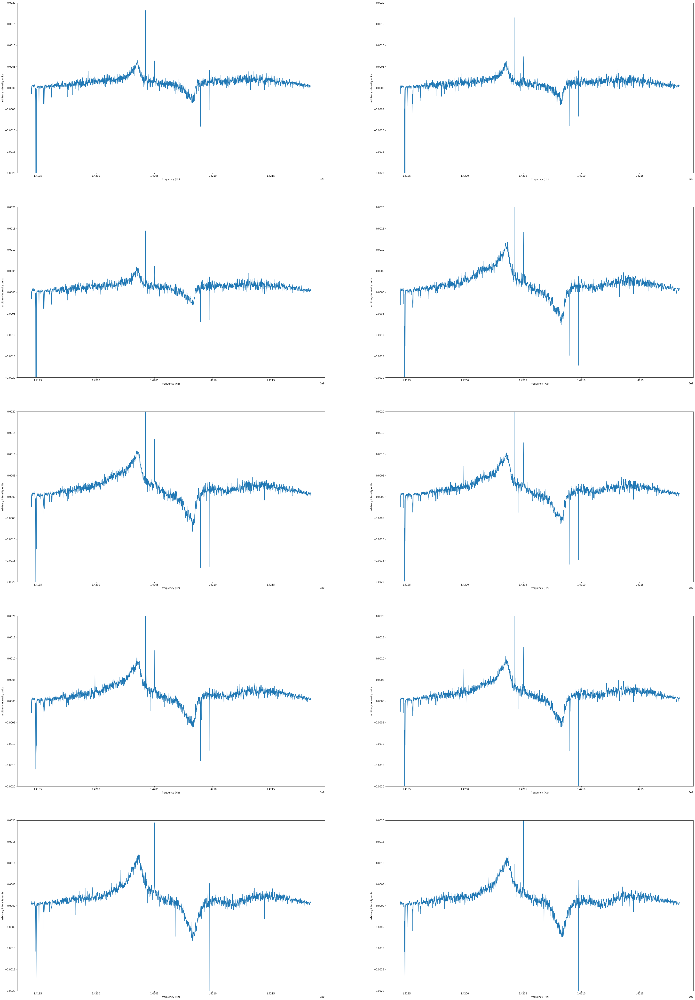

In [20]:
pl.figure(figsize=(50,75))
for ii in range(10):
    pl.subplot(5,2,ii+1).plot(group13[ii]['freq1'], group13[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')
    pl.ylim(-0.002, 0.002)

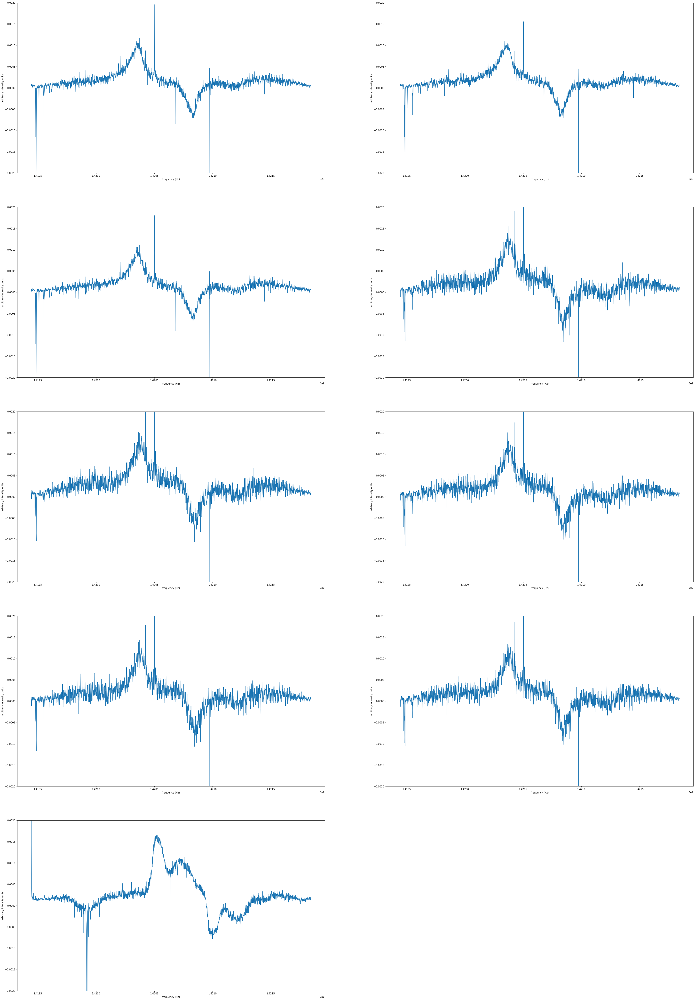

In [21]:
pl.figure(figsize=(50,75))
for ii in range(9):
    pl.subplot(5,2,ii+1).plot(group14[ii]['freq1'], group14[ii]['fsw_pow'])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')
    pl.ylim(-0.002, 0.002)

In [22]:
#potential good spectra
data = [group4[5], group2[6], group3[4], group14[1],
        group13[9], group13[3], group14[8]]

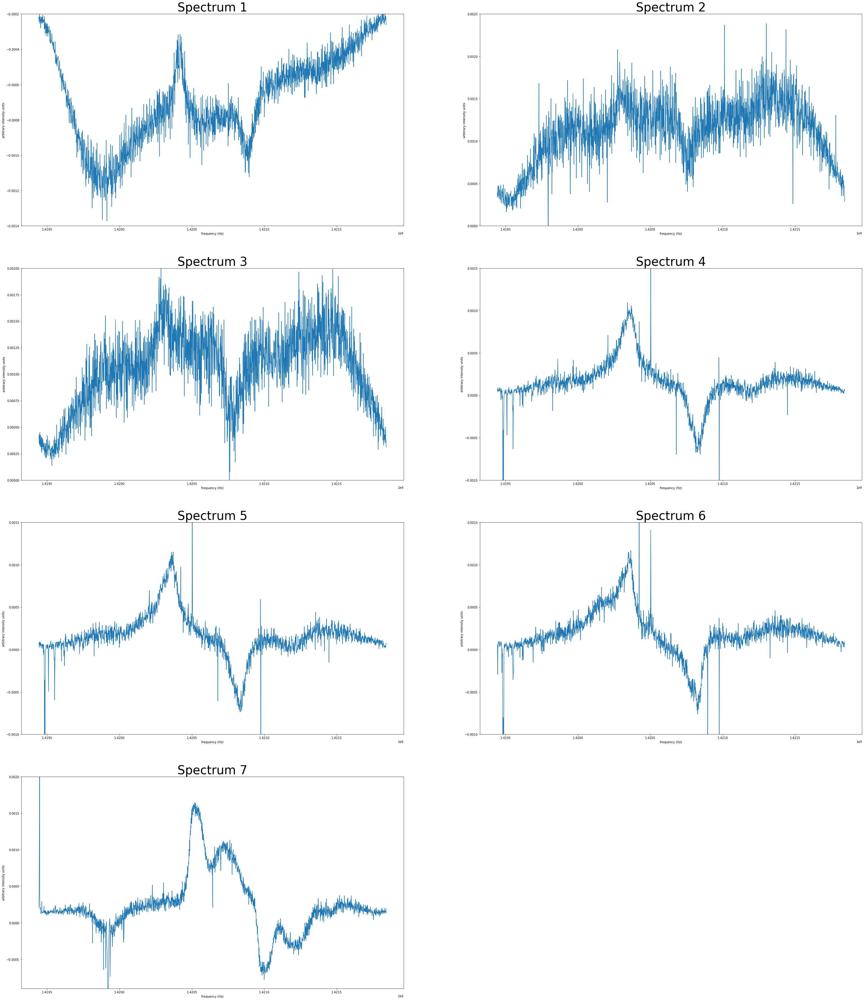

In [23]:
pl.figure(figsize=(50,75))
lims_l = [-0.0014, 0, 0, -0.001, -0.001, -0.001, -0.0009]
lims_r = [-0.0002, 0.0025, 0.002, 0.0015, 0.0015, 0.0015, 0.002]
for ii, point in enumerate(data):
    pl.subplot(5,2,ii+1).plot(point['freq1'], point['fsw_pow'])
    pl.ylim(lims_l[ii], lims_r[ii])
    pl.xlabel('frequency (Hz)')
    pl.ylabel('arbitrary intensity units')
    pl.title(f'Spectrum {ii+1}', fontsize='40')

<a id="spec1"></a>
## Measuring Velocities
#### Spectrum 1

[Index](#Index)

Text(0, 0.5, 'arbitrary intensity units')

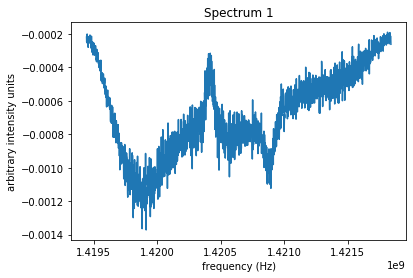

In [24]:
#selecting and zooming in on a spectrum
pl.plot(data[0]['freq1'], data[0]['fsw_pow'])
pl.title('Spectrum 1')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
#pl.axis((1.4206e9, 1.4218e9, -0.0014, -0.00015))

(1420600000.0, 1421800000.0, -0.0014, -0.00015)

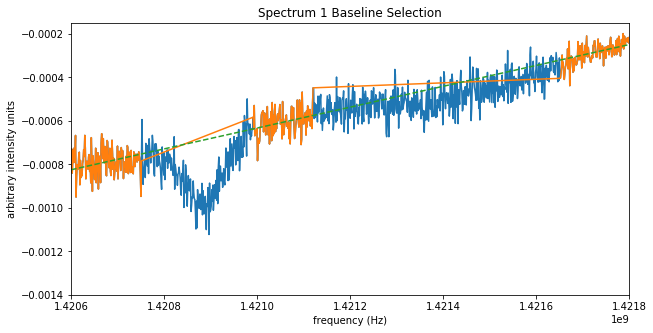

In [25]:
#selecting a baseline fit for baseline subtraction
frq1 = data[0]['freq1']*u.Hz
bl_sel1 = (((frq1 > 1.4206*u.GHz) & (frq1<1.420751*u.GHz)) |
           ((frq1 >1.42099*u.GHz) & (frq1<1.421121*u.GHz)) |
           ((frq1 >1.42165*u.GHz) & (frq1<1.42185*u.GHz)))
baseline_model1 = lnfitter(Linear1D(), frq1[bl_sel1].value, data[0]['fsw_pow'][bl_sel1])

pl.figure(figsize=(10,5))
pl.plot(data[0]['freq1'], data[0]['fsw_pow'])
pl.plot(data[0]['freq1'][bl_sel1], data[0]['fsw_pow'][bl_sel1])
pl.plot(data[0]['freq1'], baseline_model1(data[0]['freq1']), '--')

pl.title('Spectrum 1 Baseline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4206e9, 1.4218e9, -0.0014, -0.00015))

(1420700000.0, 1421800000.0, -0.0005, 0.0002)

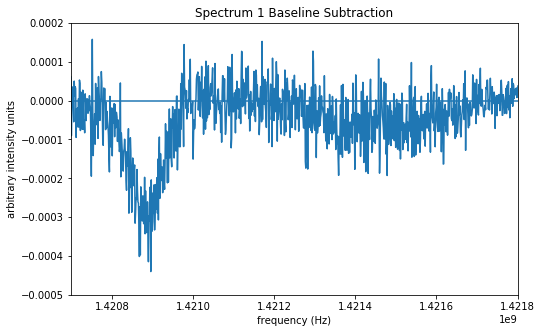

In [26]:
#subtracting the baseline and looking at it again
blsub1 = data[0]['fsw_pow'] - baseline_model1(data[0]['freq1'])

pl.figure(figsize=(8,5))
pl.plot(frq1, blsub1)
pl.axhline(0)

pl.title('Spectrum 1 Baseline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4207e9, 1.4218e9, -0.0005, 0.0002))

(1420700000.0, 1421800000.0, -0.0005, 0.0002)

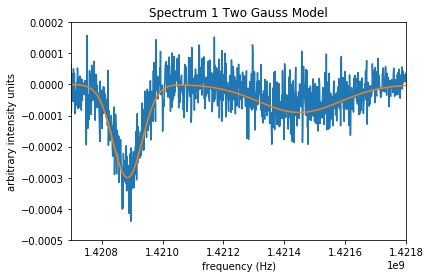

In [27]:
#fitting the spectrum
fitsel1 = (frq1>1.42075*u.GHz) & (frq1 < 1.4218*u.GHz)
two_gauss_model1 = (Gaussian1D(amplitude=-0.00030, mean=1.420885*u.GHz, stddev=48*u.kHz) +
                   Gaussian1D(amplitude=-0.00009, mean=1.42145*u.GHz, stddev=135*u.kHz))
fitted_model_again1 = fitter(two_gauss_model1, frq1[fitsel1], blsub1[fitsel1])
pl.plot(frq1, blsub1)
pl.plot(frq1, two_gauss_model1(frq1))

pl.title('Spectrum 1 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4207e9, 1.4218e9, -0.0005, 0.0002))

In [28]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, width_variance) = fitter.fit_info['param_cov'].diagonal()
uncertainty_11 = ((centroid_variance_1**0.5) / fitted_model_again1.mean_0 * constants.c).to(u.km/u.s)
uncertainty_12 = ((centroid_variance_2**0.5) / fitted_model_again1.mean_1 * constants.c).to(u.km/u.s)

<a id="spec2"></a>
#### Spectrum 2
[Index](#Index)

(1419500000.0, 1421900000.0, 0.00025, 0.002)

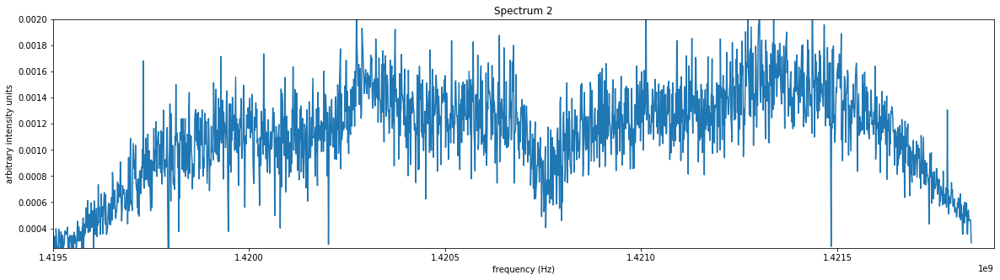

In [29]:
pl.figure(figsize=(20,5))
pl.plot(data[1]['freq1'], data[1]['fsw_pow'])

pl.title('Spectrum 2')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4219e9, 0.00025, 0.002))

(1419500000.0, 1421900000.0, 0.00025, 0.002)

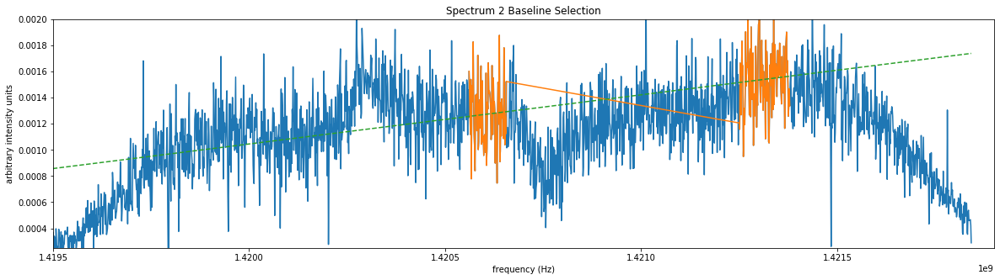

In [30]:
frq2 = data[1]['freq1']*u.Hz
bl_sel2 = (((frq2 > 1.42056*u.GHz) & (frq2<1.420657*u.GHz)) |
           ((frq2 >1.42125*u.GHz) & (frq2<1.42138*u.GHz)))
baseline_model2 = lnfitter(Linear1D(), frq2[bl_sel2].value, data[1]['fsw_pow'][bl_sel2])

pl.figure(figsize=(20,5))
pl.plot(data[1]['freq1'], data[1]['fsw_pow'])
pl.plot(data[1]['freq1'][bl_sel2], data[1]['fsw_pow'][bl_sel2])
pl.plot(data[1]['freq1'], baseline_model2(data[1]['freq1']), '--')
pl.title('Spectrum 2 Baseline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4219e9, 0.00025, 0.002))

(1419500000.0, 1421900000.0, -0.001, 0.001)

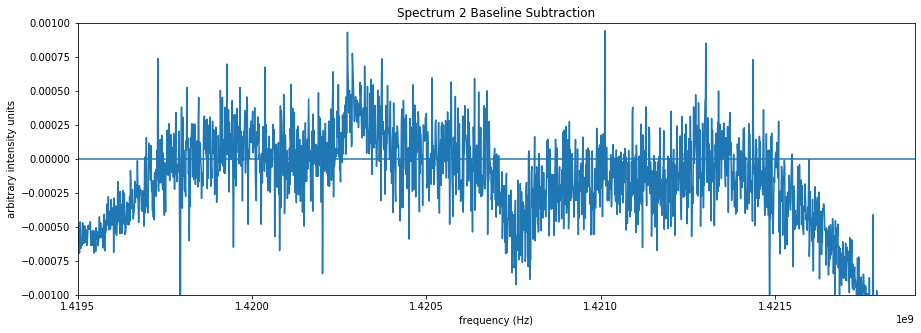

In [31]:
blsub2 = data[1]['fsw_pow'] - baseline_model2(data[1]['freq1'])

pl.figure(figsize=(15,5))
pl.plot(frq2, blsub2)
pl.axhline(0)
pl.title('Spectrum 2 Baseline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4219e9,  -0.001, 0.001))

(1420590000.0, 1421290000.0, -0.001, 0.001)

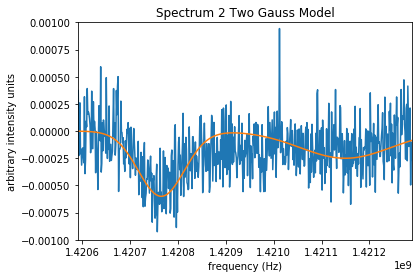

In [32]:
fitsel2 = (frq2>1.4206*u.GHz) & (frq2 < 1.4213*u.GHz)
two_gauss_model2 = (Gaussian1D(amplitude=-0.00060, mean=1.420765*u.GHz, stddev=48*u.kHz) +
                   Gaussian1D(amplitude=-0.00025, mean=1.42115*u.GHz, stddev=95*u.kHz))
fitted_model_again2 = fitter(two_gauss_model2, frq2[fitsel2], blsub2[fitsel2])
pl.plot(frq2, blsub2)
pl.plot(frq2, two_gauss_model2(frq2))
pl.title('Spectrum 2 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.42059e9, 1.42129e9,  -0.001, 0.001))

In [33]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, width_variance) = fitter.fit_info['param_cov'].diagonal()
uncertainty_21 = ((centroid_variance_1**0.5) / fitted_model_again2.mean_0 * constants.c).to(u.km/u.s)
uncertainty_22 = ((centroid_variance_2**0.5) / fitted_model_again2.mean_1 * constants.c).to(u.km/u.s)

<a id="spec3"></a>
#### Spectrum 3
[Index](#Index)

(1419500000.0, 1421900000.0, 0.00025, 0.002)

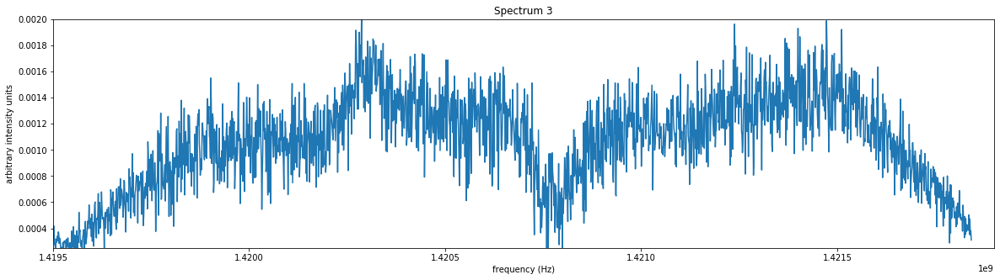

In [34]:
pl.figure(figsize=(20,5))
pl.plot(data[2]['freq1'], data[2]['fsw_pow'])
pl.title('Spectrum 3')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4219e9, 0.00025, 0.002))

(1419500000.0, 1421900000.0, 0.00025, 0.002)

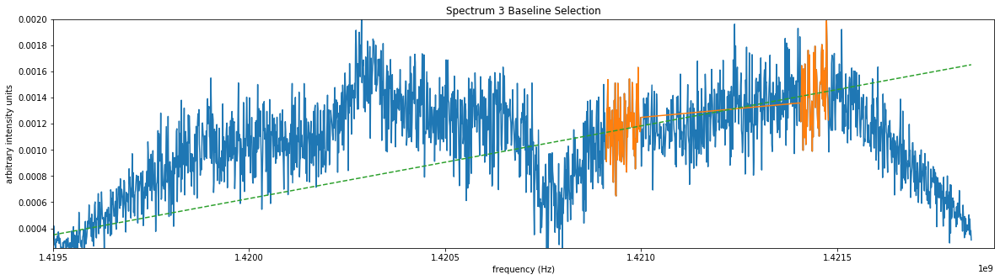

In [35]:
frq3 = data[2]['freq1']*u.Hz
bl_sel3 = (((frq3 > 1.42091*u.GHz) & (frq3<1.4210*u.GHz)) |
           ((frq3 >1.421405*u.GHz) & (frq3<1.421478*u.GHz)))
baseline_model3 = lnfitter(Linear1D(), frq3[bl_sel3].value, data[2]['fsw_pow'][bl_sel3])

pl.figure(figsize=(20,5))
pl.plot(data[2]['freq1'], data[2]['fsw_pow'])
pl.plot(data[2]['freq1'][bl_sel3], data[2]['fsw_pow'][bl_sel3])
pl.plot(data[2]['freq1'], baseline_model3(data[2]['freq1']), '--')
pl.title('Spectrum 3 Baseline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4219e9, 0.00025, 0.002))

(1419500000.0, 1421900000.0, -0.001, 0.001)

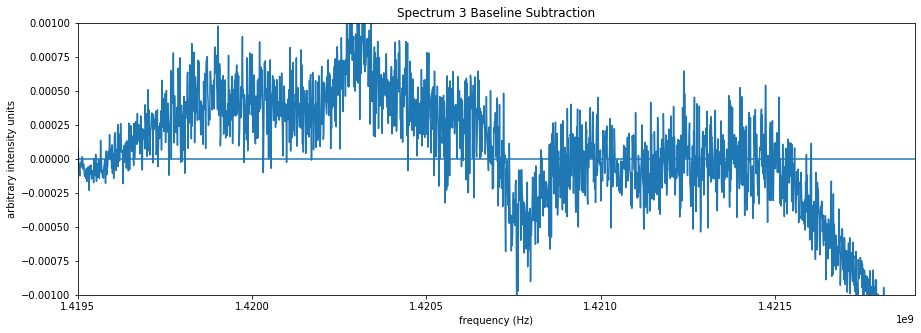

In [36]:
blsub3 = data[2]['fsw_pow'] - baseline_model3(data[2]['freq1'])

pl.figure(figsize=(15,5))
pl.plot(frq3, blsub3)
pl.axhline(0)
pl.title('Spectrum 3 Baseline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4219e9,  -0.001, 0.001))

(1420590000.0, 1421500000.0, -0.001, 0.001)

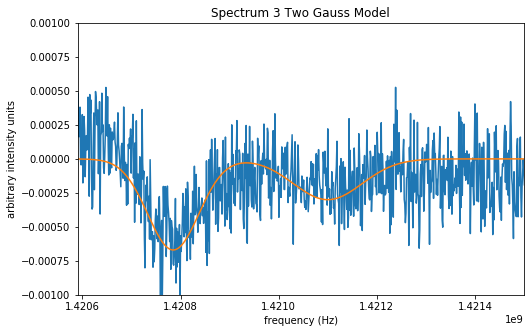

In [37]:
fitsel3 = (frq3>1.4206*u.GHz) & (frq3 < 1.4213*u.GHz)
two_gauss_model3 = (Gaussian1D(amplitude=-0.00067, mean=1.420785*u.GHz, stddev=52*u.kHz) +
                   Gaussian1D(amplitude=-0.0003, mean=1.4211*u.GHz, stddev=70*u.kHz))
fitted_model_again3 = fitter(two_gauss_model3, frq3[fitsel3], blsub3[fitsel3])

pl.figure(figsize=(8,5))
pl.plot(frq3, blsub3-0.00012)
pl.plot(frq3, two_gauss_model3(frq3))
pl.title('Spectrum 3 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.42059e9, 1.4215e9,  -0.001, 0.001))

In [38]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, width_variance) = fitter.fit_info['param_cov'].diagonal()
uncertainty_31 = ((centroid_variance_1**0.5) / fitted_model_again3.mean_0 * constants.c).to(u.km/u.s)
uncertainty_32 = ((centroid_variance_2**0.5) / fitted_model_again3.mean_1 * constants.c).to(u.km/u.s)

<a id="spec4"></a>
#### Spectrum 4
[Index](#Index)

(1419500000.0, 1421800000.0, -0.0008, 0.00125)

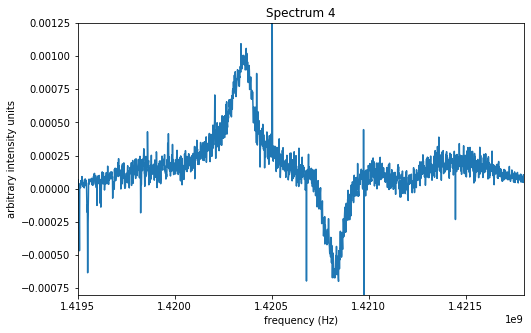

In [39]:
pl.figure(figsize=(8,5))
pl.plot(data[3]['freq1'], data[3]['fsw_pow'])
pl.title('Spectrum 4')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4218e9, -0.0008, 0.00125))

(1419500000.0, 1421800000.0, -0.0008, 0.00125)

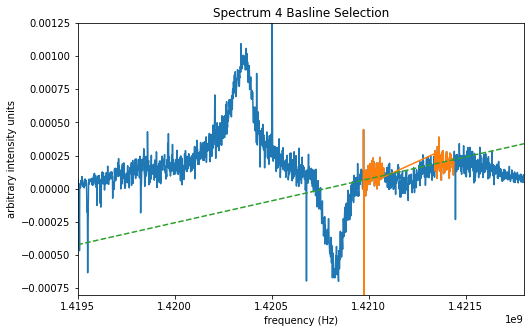

In [40]:
frq4 = data[3]['freq1']*u.Hz
bl_sel4 = (((frq4 > 1.42097*u.GHz) & (frq4<1.42108*u.GHz)) |
           ((frq4 >1.42134*u.GHz) & (frq4<1.42144*u.GHz)))
baseline_model4 = lnfitter(Linear1D(), frq4[bl_sel4].value, data[3]['fsw_pow'][bl_sel4])

pl.figure(figsize=(8,5))
pl.plot(data[3]['freq1'], data[3]['fsw_pow'])
pl.plot(data[3]['freq1'][bl_sel4], data[3]['fsw_pow'][bl_sel4])
pl.plot(data[3]['freq1'], baseline_model4(data[3]['freq1']), '--')
pl.title('Spectrum 4 Basline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4218e9, -0.0008, 0.00125))

(1420500000.0, 1421900000.0, -0.001, 0.001)

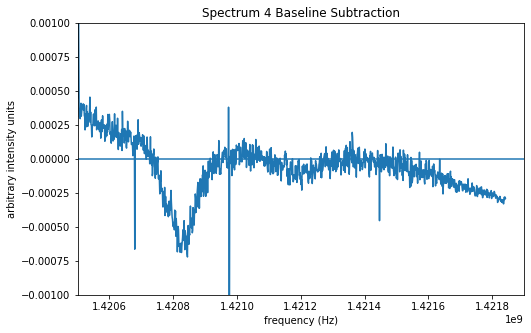

In [41]:
blsub4 = data[3]['fsw_pow'] - baseline_model4(data[3]['freq1'])

pl.figure(figsize=(8,5))
pl.plot(frq4, blsub4)
pl.axhline(0)
pl.title('Spectrum 4 Baseline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4205e9, 1.4219e9,  -0.001, 0.001))

(1420590000.0, 1421500000.0, -0.001, 0.001)

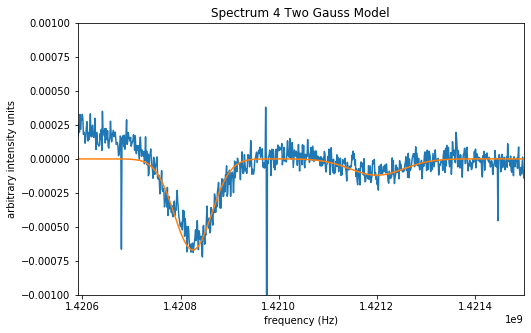

In [42]:
fitsel4 = (frq4>1.4206*u.GHz) & (frq4 < 1.4215*u.GHz)
two_gauss_model4 = (Gaussian1D(amplitude=-0.00067, mean=1.420825*u.GHz, stddev=38*u.kHz) +
                   Gaussian1D(amplitude=-0.00012, mean=1.4212*u.GHz, stddev=55*u.kHz))
fitted_model_again4 = fitter(two_gauss_model4, frq4[fitsel4], blsub4[fitsel4])

pl.figure(figsize=(8,5))
pl.plot(frq4, blsub4)
pl.plot(frq4, two_gauss_model4(frq4))
pl.title('Spectrum 4 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.42059e9, 1.4215e9,  -0.001, 0.001))

In [43]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, width_variance) = fitter.fit_info['param_cov'].diagonal()
uncertainty_41 = ((centroid_variance_1**0.5) / fitted_model_again4.mean_0 * constants.c).to(u.km/u.s)
uncertainty_42 = ((centroid_variance_2**0.5) / fitted_model_again4.mean_1 * constants.c).to(u.km/u.s)

<a id="spec5"></a>
#### Spectrum 5
[Index](#Index)

(-0.001, 0.0015)

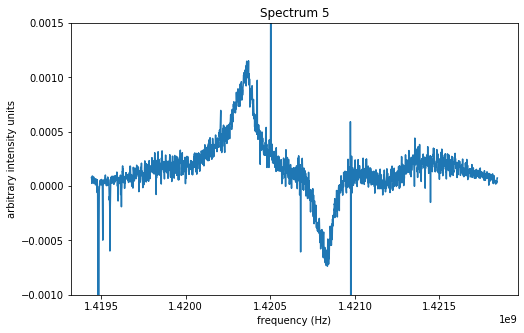

In [44]:
pl.figure(figsize=(8,5))
pl.plot(data[4]['freq1'], data[4]['fsw_pow'])
pl.title('Spectrum 5')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.ylim(-0.001, 0.0015)

Text(0, 0.5, 'arbitrary intensity units')

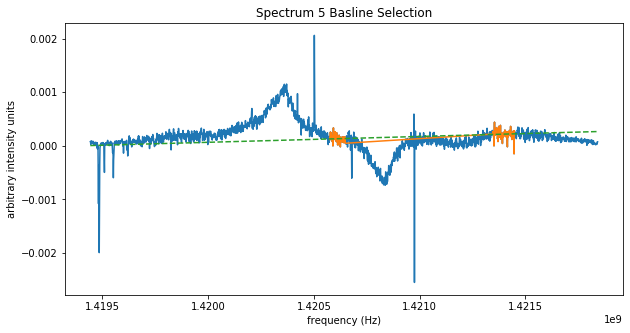

In [45]:
frq5 = data[4]['freq1']*u.Hz
bl_sel5 = (((frq5 >1.420575*u.GHz) & (frq5<1.42065*u.GHz)) |
           ((frq5 >1.421345*u.GHz) & (frq5<1.42145*u.GHz)))
baseline_model5 = lnfitter(Linear1D(), frq5[bl_sel5].value, data[4]['fsw_pow'][bl_sel5])

pl.figure(figsize=(10,5))
pl.plot(data[4]['freq1'], data[4]['fsw_pow'])
pl.plot(data[4]['freq1'][bl_sel5], data[4]['fsw_pow'][bl_sel5])
pl.plot(data[4]['freq1'], baseline_model5(data[4]['freq1']), '--')
pl.title('Spectrum 5 Basline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')

Text(0, 0.5, 'arbitrary intensity units')

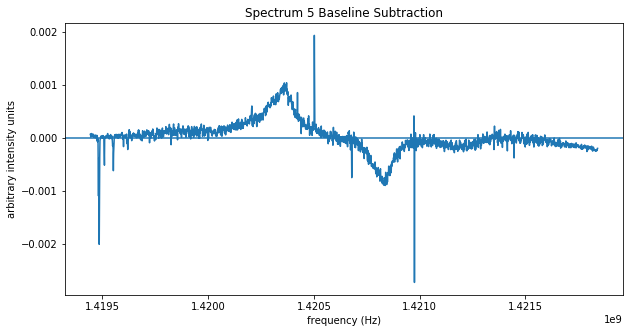

In [46]:
blsub5 = data[4]['fsw_pow'] - baseline_model5(data[4]['freq1'])

pl.figure(figsize=(10,5))
pl.plot(frq5, blsub5)
pl.axhline(0)
pl.title('Spectrum 5 Baseline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')

(1420600000.0, 1421450000.0, -0.0015, 0.0005)

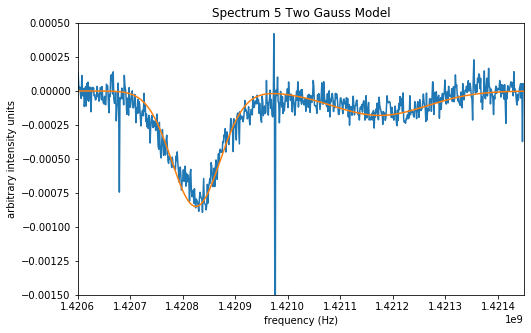

In [47]:
fitsel5 = (frq5>1.4206*u.GHz) & (frq5 < 1.4213*u.GHz)
two_gauss_model5 = (Gaussian1D(amplitude=-0.00085, mean=1.420825*u.GHz, stddev=46*u.kHz) +
                   Gaussian1D(amplitude=-0.00018, mean=1.421175*u.GHz, stddev=90*u.kHz))
fitted_model_again5 = fitter(two_gauss_model5, frq5[fitsel5], blsub5[fitsel5])

pl.figure(figsize=(8,5))
pl.plot(frq5, blsub5)
pl.plot(frq5, two_gauss_model5(frq5))
pl.title('Spectrum 5 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')

pl.axis((1.4206e9, 1.42145e9, -0.0015, 0.0005))

In [48]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, width_variance) = fitter.fit_info['param_cov'].diagonal()
uncertainty_51 = ((centroid_variance_1**0.5) / fitted_model_again5.mean_0 * constants.c).to(u.km/u.s)
uncertainty_52 = ((centroid_variance_2**0.5) / fitted_model_again5.mean_1 * constants.c).to(u.km/u.s)

<a id="spec6"></a>
#### Spectrum 6 
[Index](#Index)

(1419500000.0, 1421800000.0, -0.001, 0.0015)

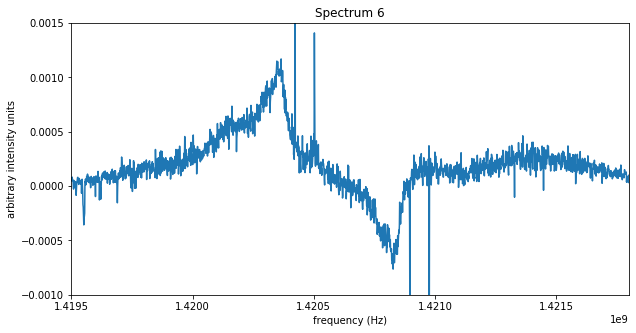

In [49]:
pl.figure(figsize=(10,5))
pl.plot(data[5]['freq1'], data[5]['fsw_pow'])
pl.title('Spectrum 6')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4218e9, -0.001, 0.0015))

(1419500000.0, 1421800000.0, -0.001, 0.0015)

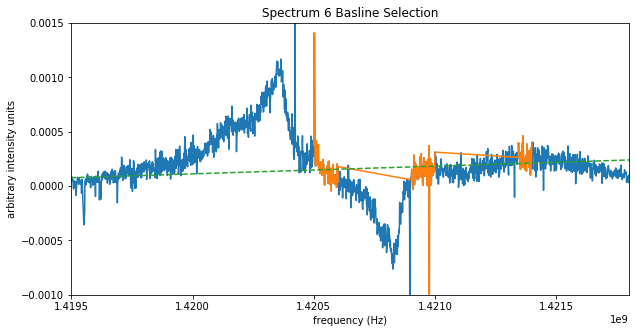

In [50]:
frq6 = data[5]['freq1']*u.Hz
bl_sel6 = (((frq6 >1.4205*u.GHz) & (frq6<1.4206*u.GHz)) |
           ((frq6 >1.4209*u.GHz) & (frq6<1.4210*u.GHz)) |
           ((frq6 >1.42134*u.GHz) & (frq6<1.4214*u.GHz)))
baseline_model6 = lnfitter(Linear1D(), frq6[bl_sel6].value, data[5]['fsw_pow'][bl_sel6])

pl.figure(figsize=(10,5))
pl.plot(data[5]['freq1'], data[5]['fsw_pow'])
pl.plot(data[5]['freq1'][bl_sel6], data[5]['fsw_pow'][bl_sel6])
pl.plot(data[5]['freq1'], baseline_model6(data[5]['freq1']), '--')
pl.title('Spectrum 6 Basline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4218e9, -0.001, 0.0015))

Text(0, 0.5, 'arbitrary intensity units')

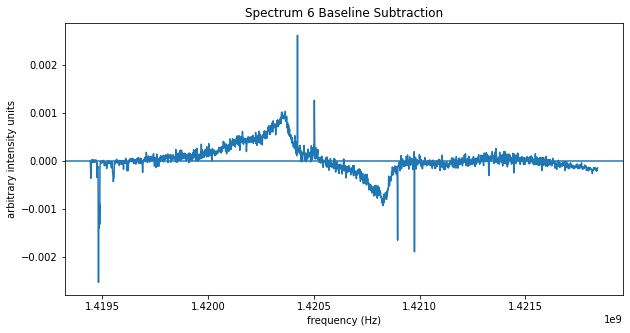

In [51]:
blsub6 = data[5]['fsw_pow'] - baseline_model6(data[5]['freq1'])

pl.figure(figsize=(10,5))
pl.plot(frq6, blsub6)
pl.axhline(0)
pl.title('Spectrum 6 Baseline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')

(1420600000.0, 1421600000.0, -0.0015, 0.0005)

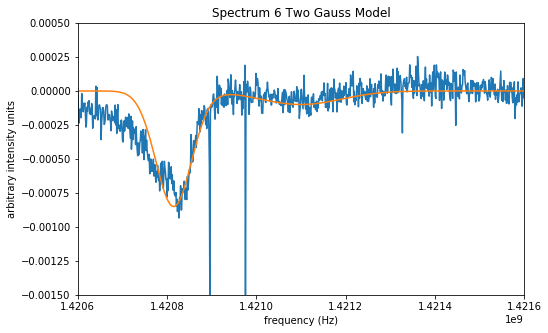

In [52]:
fitsel6 = (frq6 >1.4206*u.GHz) & (frq6 < 1.4214*u.GHz)
two_gauss_model6 = (Gaussian1D(amplitude=-0.00085, mean=1.420815*u.GHz, stddev=40*u.kHz) +
                   Gaussian1D(amplitude=-0.0001, mean=1.4211*u.GHz, stddev=90*u.kHz))
fitted_model_again6 = fitter(two_gauss_model6, frq6[fitsel6], blsub6[fitsel6])

pl.figure(figsize=(8,5))
pl.plot(frq6, blsub6)
pl.plot(frq6, two_gauss_model6(frq6))
pl.title('Spectrum 6 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')

pl.axis((1.4206e9, 1.4216e9, -0.0015, 0.0005))

In [53]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, width_variance) = fitter.fit_info['param_cov'].diagonal()
uncertainty_61 = ((centroid_variance_1**0.5) / fitted_model_again6.mean_0 * constants.c).to(u.km/u.s)
uncertainty_62 = ((centroid_variance_2**0.5) / fitted_model_again6.mean_1 * constants.c).to(u.km/u.s)

<a id="spec7"></a>
#### Spectrum 7 
[Index](#Index)

(1420200000.0, 1421700000.0, -0.0008, 0.002)

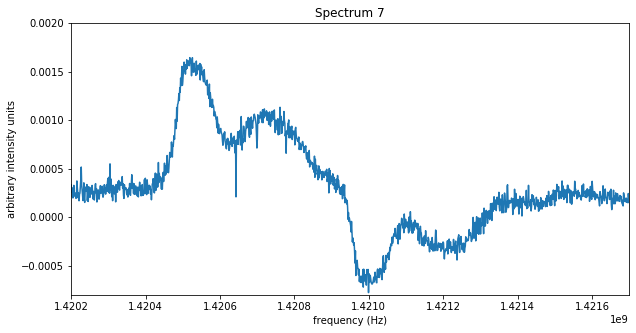

In [54]:
pl.figure(figsize=(10,5))
pl.plot(data[6]['freq1'], data[6]['fsw_pow'])
pl.title('Spectrum 7')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4202e9, 1.4217e9, -0.0008, 0.002))

(1419500000.0, 1421800000.0, -0.001, 0.0015)

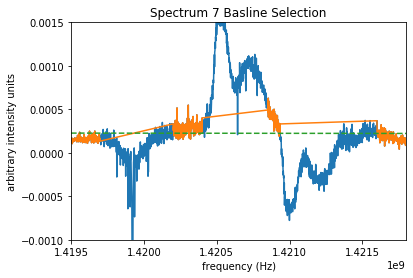

In [55]:
frq7 = data[6]['freq1']*u.Hz
bl_sel7 = (((frq7 > 1.4195*u.GHz) & (frq7<1.4197*u.GHz)) |
           ((frq7 > 1.42085*u.GHz) & (frq7<1.420935*u.GHz)) |
           (frq7 > 1.4216*u.GHz) |
           ((frq7 >1.4202*u.GHz) & (frq7<1.4204*u.GHz)))
baseline_model7 = lnfitter(Linear1D(), frq7[bl_sel7].value, data[6]['fsw_pow'][bl_sel7])
pl.plot(data[6]['freq1'], data[6]['fsw_pow'])
pl.plot(data[6]['freq1'][bl_sel7], data[6]['fsw_pow'][bl_sel7])
pl.plot(data[6]['freq1'], baseline_model7(data[6]['freq1']), '--')
pl.title('Spectrum 7 Basline Selection')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4195e9, 1.4218e9, -0.001, 0.0015))

(1420200000.0, 1421700000.0, -0.001, 0.0015)

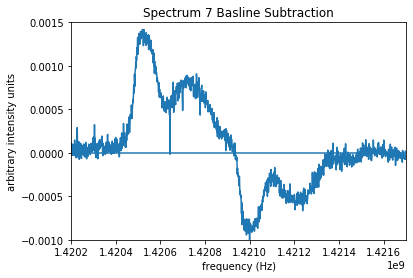

In [56]:
blsub7 = data[6]['fsw_pow'] - baseline_model7(data[6]['freq1'])
pl.plot(frq7, blsub7)
pl.axhline(0)
pl.title('Spectrum 7 Basline Subtraction')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4202e9, 1.4217e9, -0.001, 0.0015))

(1420900000.0, 1421650000.0, -0.001, 0.0015)

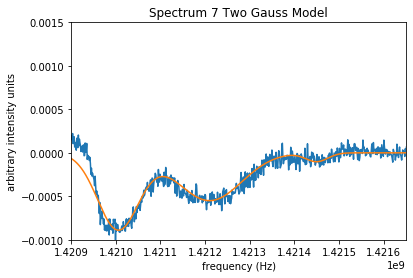

In [57]:
fitsel7 = (frq7>1.42095*u.GHz) & (frq7 < 1.4216*u.GHz)
two_gauss_model7 = (Gaussian1D(amplitude=-0.00088, mean=1.421005*u.GHz, stddev=46*u.kHz) +
                   Gaussian1D(amplitude=-0.00055, mean=1.42121*u.GHz, stddev=72*u.kHz) +
                   Gaussian1D(amplitude=-0.0001, mean=1.42145*u.GHz, stddev=25*u.kHz))
fitted_model_again7 = fitter(two_gauss_model7, frq7[fitsel7], blsub7[fitsel7])
pl.plot(frq7, blsub7)
pl.plot(frq7, two_gauss_model7(frq7))

pl.title('Spectrum 7 Two Gauss Model')
pl.xlabel('frequency (Hz)')
pl.ylabel('arbitrary intensity units')
pl.axis((1.4209e9, 1.42165e9, -0.001, 0.0015))

In [58]:
#errors 
(slope_variance, intercept_variance,
 amplitude_variance, centroid_variance_1, centroid_variance_2, centroid_variance_3, width_variance, test1, test2) = fitter.fit_info['param_cov'].diagonal()
uncertainty_71 = ((centroid_variance_1**0.5) / fitted_model_again7.mean_0 * constants.c).to(u.km/u.s)
uncertainty_72 = ((centroid_variance_2**0.5) / fitted_model_again7.mean_1 * constants.c).to(u.km/u.s)
uncertainty_73 = ((centroid_variance_3**0.5) / fitted_model_again7.mean_2 * constants.c).to(u.km/u.s)

<a id="galloc"></a>
## Galactic Location

[Index](#Index)

Text(0.5, 1.0, 'Selected Spectra Locations Plotted on the Galaxy')

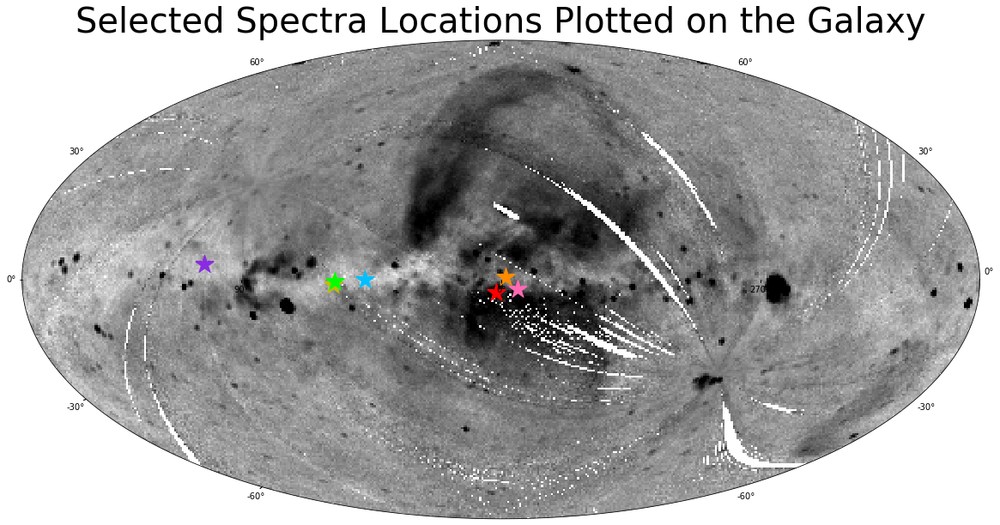

In [59]:
#metadata that was used
used_data = [useable_data[35], useable_data[16], useable_data[24], useable_data[131], 
             useable_data[129], useable_data[123], metadata_table_onsky[1676]]
filename = get_pkg_data_filename('allsky/allsky_rosat.fits')
hdu = fits.open(filename)[0]
wcs = WCS(hdu.header)
data_wcs = hdu.data
pl.figure(figsize=(20,15))
ax = pl.subplot(projection=wcs, frame_class=EllipticalFrame)
im = ax.imshow(data_wcs, origin='lower', cmap='gray_r', interpolation='none',
               norm=simple_norm(data_wcs, stretch='asinh', max_percent=99.5, min_percent=1))
#i like color coding things
colors = ['hotpink', 'r', 'darkorange', 'y', 'lime', 'deepskyblue', 'blueviolet']

for ii, data_pt in enumerate(used_data):
    ax.scatter(data_pt['glon']*u.deg, data_pt['glat']*u.deg, s=500, marker='*', color=colors[ii], transform=ax.get_transform('galactic'))

pl.title('Selected Spectra Locations Plotted on the Galaxy', fontsize='40')

<a id="los"></a>
## Line of Sight Velocities
### Topocentric

[Index](#Index)

In [60]:
#rest frequence of hydrogen
nu_hi = 1420.405751 * u.MHz
velocity_topo11 = ((nu_hi - fitted_model_again1.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo12 = ((nu_hi - fitted_model_again1.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo21 = ((nu_hi - fitted_model_again2.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo22 = ((nu_hi - fitted_model_again2.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo31 = ((nu_hi - fitted_model_again3.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo32 = ((nu_hi - fitted_model_again3.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo41 = ((nu_hi - fitted_model_again4.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo42 = ((nu_hi - fitted_model_again4.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo51 = ((nu_hi - fitted_model_again5.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo52 = ((nu_hi - fitted_model_again5.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo61 = ((nu_hi - fitted_model_again6.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo62 = ((nu_hi - fitted_model_again6.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo71 = ((nu_hi - fitted_model_again7.mean_0) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo72 = ((nu_hi - fitted_model_again7.mean_1) / nu_hi * constants.c).to(u.km/u.s)
velocity_topo73 = ((nu_hi - fitted_model_again7.mean_2) / nu_hi * constants.c).to(u.km/u.s)
topocentric = [[velocity_topo11, velocity_topo12], [velocity_topo21, velocity_topo22], [velocity_topo31, 
               velocity_topo32], [velocity_topo41, velocity_topo42], [velocity_topo51, velocity_topo52], 
               [velocity_topo61, velocity_topo62], [velocity_topo71, velocity_topo72, velocity_topo73]]

In [61]:
errors_v = [uncertainty_11, uncertainty_12, uncertainty_21, uncertainty_22, uncertainty_31, uncertainty_32, 
            uncertainty_41, uncertainty_42, uncertainty_51, uncertainty_52, uncertainty_61, uncertainty_62, 
            uncertainty_71, uncertainty_72, uncertainty_73]

<a id="bary"></a>
### Barycentric 
[Index](#Index)

In [62]:
#using the daial velocity correction to go from topo to barycentric
v_bary_11 = velocity_topo11 + (used_data[0]['rvcorr'] *u.m/u.s)
v_bary_12 = velocity_topo12 + (used_data[0]['rvcorr'] *u.m/u.s)
v_bary_21 = velocity_topo21 + (used_data[1]['rvcorr'] *u.m/u.s)
v_bary_22 = velocity_topo22 + (used_data[1]['rvcorr'] *u.m/u.s)
v_bary_31 = velocity_topo31 + (used_data[2]['rvcorr'] *u.m/u.s)
v_bary_32 = velocity_topo32 + (used_data[2]['rvcorr'] *u.m/u.s)
v_bary_41 = velocity_topo41 + (used_data[3]['rvcorr'] *u.m/u.s)
v_bary_42 = velocity_topo42 + (used_data[3]['rvcorr'] *u.m/u.s)
v_bary_51 = velocity_topo51 + (used_data[4]['rvcorr'] *u.m/u.s)
v_bary_52 = velocity_topo52 + (used_data[4]['rvcorr'] *u.m/u.s)
v_bary_61 = velocity_topo61 + (used_data[5]['rvcorr'] *u.m/u.s)
v_bary_62 = velocity_topo62 + (used_data[5]['rvcorr'] *u.m/u.s)
v_bary_71 = velocity_topo71 + (used_data[6]['rvcorr'] *u.m/u.s)
v_bary_72 = velocity_topo72 + (used_data[6]['rvcorr'] *u.m/u.s)
v_bary_73 = velocity_topo73 + (used_data[6]['rvcorr'] *u.m/u.s)
barycentric = [[v_bary_11, v_bary_12], [v_bary_21, v_bary_22], [v_bary_31, v_bary_32], [v_bary_41, v_bary_42], 
              [v_bary_51, v_bary_52], [v_bary_61, v_bary_62], [v_bary_71, v_bary_72, v_bary_73]]

<a id="lsr"></a>
### LSR
[Index](#Index)

In [63]:
#barycentric to irs velocity
irs_11 = ((coordinates.ICRS(ra=used_data[0]['sky'].icrs.ra, dec=used_data[0]['sky'].icrs.dec,
                                    radial_velocity=v_bary_11,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_12 = ((coordinates.ICRS(ra=used_data[0]['sky'].icrs.ra, dec=used_data[0]['sky'].icrs.dec,
                                    radial_velocity=v_bary_12,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_21 = ((coordinates.ICRS(ra=used_data[1]['sky'].icrs.ra, dec=used_data[1]['sky'].icrs.dec,
                                    radial_velocity=v_bary_21,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_22 = ((coordinates.ICRS(ra=used_data[1]['sky'].icrs.ra, dec=used_data[1]['sky'].icrs.dec,
                                    radial_velocity=v_bary_22,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_31 = ((coordinates.ICRS(ra=used_data[2]['sky'].icrs.ra, dec=used_data[2]['sky'].icrs.dec,
                                    radial_velocity=v_bary_31,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_32 = ((coordinates.ICRS(ra=used_data[2]['sky'].icrs.ra, dec=used_data[2]['sky'].icrs.dec,
                                    radial_velocity=v_bary_32,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_41 = ((coordinates.ICRS(ra=used_data[3]['sky'].icrs.ra, dec=used_data[3]['sky'].icrs.dec,
                                    radial_velocity=v_bary_41,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_42 = ((coordinates.ICRS(ra=used_data[3]['sky'].icrs.ra, dec=used_data[3]['sky'].icrs.dec,
                                    radial_velocity=v_bary_42,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_51 = ((coordinates.ICRS(ra=used_data[4]['sky'].icrs.ra, dec=used_data[4]['sky'].icrs.dec,
                                    radial_velocity=v_bary_51,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_52 = ((coordinates.ICRS(ra=used_data[4]['sky'].icrs.ra, dec=used_data[4]['sky'].icrs.dec,
                                    radial_velocity=v_bary_52,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_61 = ((coordinates.ICRS(ra=used_data[5]['sky'].icrs.ra, dec=used_data[5]['sky'].icrs.dec,
                                    radial_velocity=v_bary_61,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_62 = ((coordinates.ICRS(ra=used_data[5]['sky'].icrs.ra, dec=used_data[5]['sky'].icrs.dec,
                                    radial_velocity=v_bary_62,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_71 = ((coordinates.ICRS(ra=used_data[6]['sky'].icrs.ra, dec=used_data[6]['sky'].icrs.dec,
                                    radial_velocity=v_bary_71,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_72 = ((coordinates.ICRS(ra=used_data[6]['sky'].icrs.ra, dec=used_data[6]['sky'].icrs.dec,
                                    radial_velocity=v_bary_72,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity
irs_73 = ((coordinates.ICRS(ra=used_data[6]['sky'].icrs.ra, dec=used_data[6]['sky'].icrs.dec,
                                    radial_velocity=v_bary_73,
                                    pm_ra_cosdec=0*u.arcmin/u.yr, pm_dec=0*u.arcmin/u.yr, 
                                    distance=1*u.pc)).transform_to(coordinates.LSR)).radial_velocity

irs = [[irs_11, irs_12], [irs_21, irs_22], [irs_31, irs_32], [irs_41, irs_42], [irs_51, irs_52], 
               [irs_61, irs_62], [irs_11, irs_72, irs_73]]

<a id="fitted"></a>
## Fitted Velocities v. Galactic Radii
### Expected Velocities
[Index](#Index)

In [64]:
#galactic radius from sun to center
r0 = 8.5*u.kpc
#all of the radii forced positive
rad1 = abs(r0 * np.sin(used_data[0]['glon']*u.deg))
rad2 = abs(r0 * np.sin(used_data[1]['glon']*u.deg))
rad3 = abs(r0 * np.sin(used_data[2]['glon']*u.deg))
rad4 = abs(r0 * np.sin(used_data[3]['glon']*u.deg))
rad5 = abs(r0 * np.sin(used_data[4]['glon']*u.deg))
rad6 = abs(r0 * np.sin(used_data[5]['glon']*u.deg))
rad7 = abs(r0 * np.sin(used_data[6]['glon']*u.deg))
radii = [rad1, rad2, rad3, rad4, rad5, rad6, rad7]
#converting glons from 270-90 to -90-90
glon_temp = [used_data[0]['glon']*u.deg, used_data[1]['glon']*u.deg, used_data[2]['glon']*u.deg, 
         used_data[3]['glon']*u.deg, used_data[4]['glon']*u.deg, used_data[5]['glon']*u.deg, 
         used_data[6]['glon']*u.deg]
glons = []
for glon in glon_temp:
    if glon > 270*u.deg:
        glons.append(glon-360*u.deg)
    else:
        glons.append(glon)
#sun's velocity
v_sun=220*u.km/u.s

def vel1(rad, ii):
    '''
    constant mass velocity function
    '''
    mass = v_sun**2 *r0/constants.G
    velocity = (constants.G*mass/rad)**(1/2)
    vel = velocity.to(u.km/u.s)
    vel_corrected = vel - v_sun*np.sin(used_data[ii]['glon']*u.deg)
    return vel_corrected

def vel2(rad, ii):
    '''
    linear mass velocity function
    '''
    m0 = v_sun**2*10*u.pc/constants.G
    mass = m0*rad/(10*u.pc)
    velocity = (constants.G*mass/rad)**(1/2)
    vel = velocity.to(u.km/u.s)
    vel_corrected = vel - v_sun*np.sin(used_data[ii]['glon']*u.deg)
    return vel_corrected

def vel3(rad, ii):
    '''
    squared mass velocity function
    '''
    m0 = v_sun**2*(100*u.pc)**2/(constants.G*r0)
    mass = m0* (rad/(100*u.pc))**2
    velocity = (constants.G*mass/rad)**(1/2)
    vel = velocity.to(u.km/u.s)
    vel_corrected = vel - v_sun*np.sin(used_data[ii]['glon']*u.deg)
    return vel_corrected

expected_vels_1 = [vel1(rad1, 0), vel1(rad2, 1), vel1(rad3, 2), vel1(rad4, 3), vel1(rad5, 4), vel1(rad6, 5), vel1(rad7, 6)]
expected_vels_2 = [vel2(rad1, 0), vel2(rad2, 1), vel2(rad3, 2), vel2(rad4, 3), vel2(rad5, 4), vel2(rad6, 5), vel2(rad7, 6)]
expected_vels_3 = [vel3(rad1, 0), vel3(rad2, 1), vel3(rad3, 2), vel3(rad4, 3), vel3(rad5, 4), vel3(rad6, 5), vel3(rad7, 6)]

In [65]:
#showing the velocity functions as solid lines
x = (np.linspace(-10, 110, 1000))*u.deg
expected_constant = ((v_sun**2/abs(np.sin(x)))**(1/2)-v_sun*np.sin(x)).to(u.km/u.s)
expected_linear = (v_sun-v_sun*np.sin(x)).to(u.km/u.s)
expected_kepler = ((v_sun**2*abs(np.sin(x)))**(1/2)-v_sun*np.sin(x)).to(u.km/u.s)

In [66]:
# best fit lines
irs_1 = [point[0].value for point in irs]
#irs_1.pop(4)
irs_2 = [point[1].value for point in irs]
#irs_2.pop(4)
xvals = [glon.value for glon in glons]
#xvals.pop(4)
xs = np.linspace(-10, 110, 1000)
polymodel = Polynomial1D(degree=3)
fitted_polymodel_1 = fitter(polymodel, xvals, irs_1)
fitted_polymodel_2 = fitter(polymodel, xvals, irs_2)

green_line = fitted_polymodel_1(xs)*u.km/u.s
blue_line = fitted_polymodel_2(xs)*u.km/u.s

predicted_velocity_1 = fitted_polymodel_1(90)*u.km/u.s
predicted_velocity_2 = fitted_polymodel_2(90)*u.km/u.s

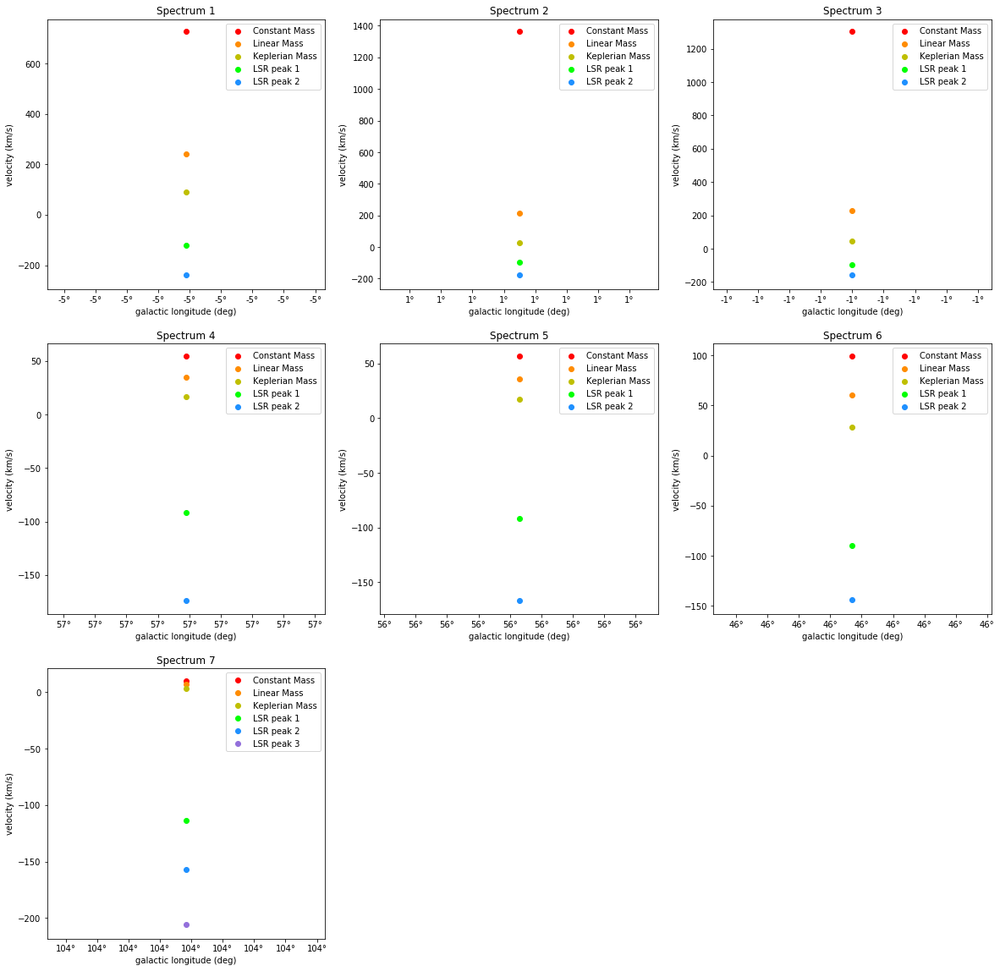

In [67]:
pl.figure(figsize=(20,20))
ax1 = pl.subplot(3,3,1)
pl.title('Spectrum 1')
ax1.scatter(glons[0], expected_vels_1[0], color='r', label='Constant Mass')
ax1.scatter(glons[0], expected_vels_2[0], color='darkorange', label='Linear Mass')
ax1.scatter(glons[0], expected_vels_3[0], color='y', label='Keplerian Mass')
ax1.scatter(glons[0], irs_11, color='lime', label='LSR peak 1')
ax1.scatter(glons[0], irs_12, color='dodgerblue',label='LSR peak 2')
ax1.legend()
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax2 = pl.subplot(3,3,2)
pl.title('Spectrum 2')
ax2.scatter(glons[1], expected_vels_1[1], color='r', label='Constant Mass')
ax2.scatter(glons[1], expected_vels_2[1], color='darkorange', label='Linear Mass')
ax2.scatter(glons[1], expected_vels_3[1], color='y', label='Keplerian Mass')
ax2.scatter(glons[1], irs_21, color='lime', label='LSR peak 1')
ax2.scatter(glons[1], irs_22, color='dodgerblue',label='LSR peak 2')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax2.legend()
ax3 = pl.subplot(3,3,3)
pl.title('Spectrum 3')
ax3.scatter(glons[2], expected_vels_1[2], color='r', label='Constant Mass')
ax3.scatter(glons[2], expected_vels_2[2], color='darkorange', label='Linear Mass')
ax3.scatter(glons[2], expected_vels_3[2], color='y', label='Keplerian Mass')
ax3.scatter(glons[2], irs_31, color='lime', label='LSR peak 1')
ax3.scatter(glons[2], irs_32, color='dodgerblue',label='LSR peak 2')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax3.legend()
ax4 = pl.subplot(3,3,4)
pl.title('Spectrum 4')
ax4.scatter(glons[3], expected_vels_1[3], color='r', label='Constant Mass')
ax4.scatter(glons[3], expected_vels_2[3], color='darkorange', label='Linear Mass')
ax4.scatter(glons[3], expected_vels_3[3], color='y', label='Keplerian Mass')
ax4.scatter(glons[3], irs_41, color='lime', label='LSR peak 1')
ax4.scatter(glons[3], irs_42, color='dodgerblue',label='LSR peak 2')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax4.legend()
ax5 = pl.subplot(3,3,5)
pl.title('Spectrum 5')
ax5.scatter(glons[4], expected_vels_1[4], color='r', label='Constant Mass')
ax5.scatter(glons[4], expected_vels_2[4], color='darkorange', label='Linear Mass')
ax5.scatter(glons[4], expected_vels_3[4], color='y', label='Keplerian Mass')
ax5.scatter(glons[4], irs_51, color='lime', label='LSR peak 1')
ax5.scatter(glons[4], irs_52, color='dodgerblue',label='LSR peak 2')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax5.legend()
ax6 = pl.subplot(3,3,6)
pl.title('Spectrum 6')
ax6.scatter(glons[5], expected_vels_1[5], color='r', label='Constant Mass')
ax6.scatter(glons[5], expected_vels_2[5], color='darkorange', label='Linear Mass')
ax6.scatter(glons[5], expected_vels_3[5], color='y', label='Keplerian Mass')
ax6.scatter(glons[5], irs_61, color='lime', label='LSR peak 1')
ax6.scatter(glons[5], irs_62, color='dodgerblue',label='LSR peak 2')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax6.legend()
ax7 = pl.subplot(3,3,7)
pl.title('Spectrum 7')
ax7.scatter(glons[6], expected_vels_1[6], color='r', label='Constant Mass')
ax7.scatter(glons[6], expected_vels_2[6], color='darkorange', label='Linear Mass')
ax7.scatter(glons[6], expected_vels_3[6], color='y', label='Keplerian Mass')
ax7.scatter(glons[6], irs_71, color='lime', label='LSR peak 1')
ax7.scatter(glons[6], irs_72, color='dodgerblue',label='LSR peak 2')
ax7.scatter(glons[6], irs_73, color='mediumpurple',label='LSR peak 3')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax7.legend()

Text(0.5, 1.0, 'Velocity v. Galactic Longitude Zoomed In')

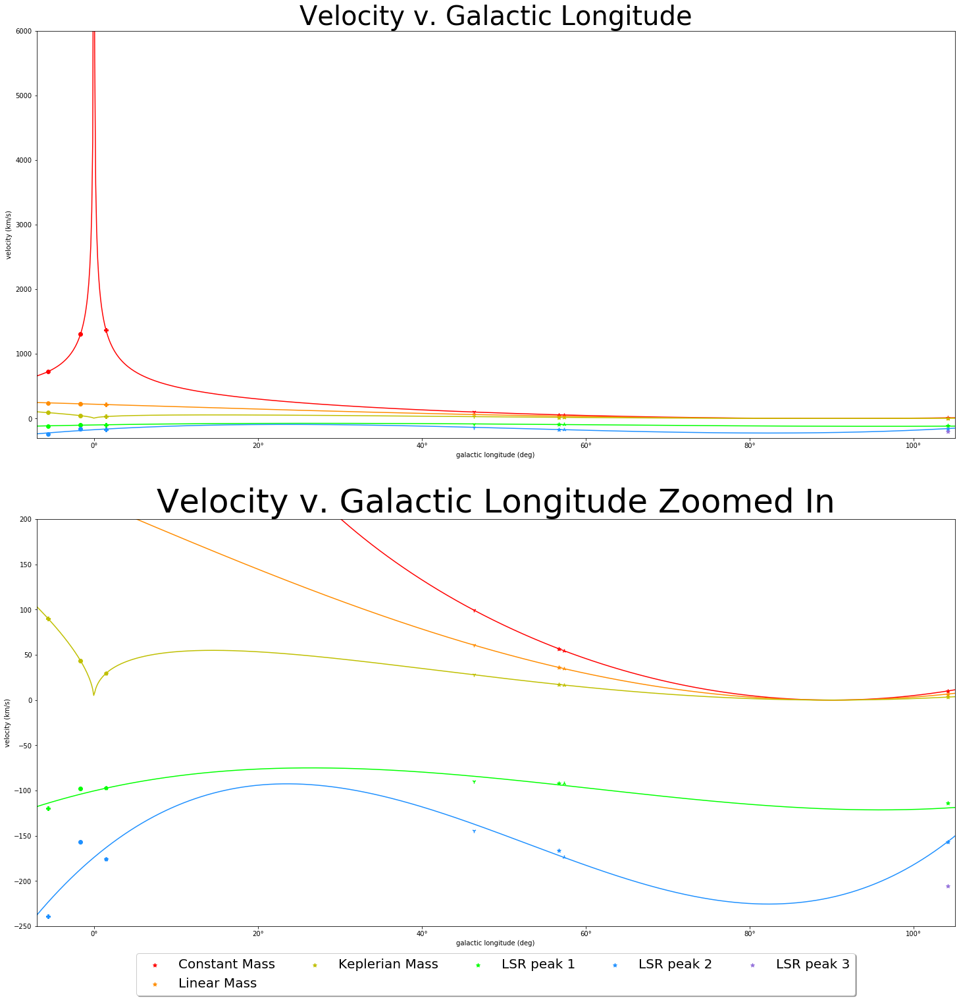

In [68]:
pl.figure(figsize=(25,25))
ax1 = pl.subplot(2,1,1)
ax1.plot(x, expected_constant, color='r')
ax1.plot(x, expected_linear, color='darkorange')
ax1.plot(x, expected_kepler, color='y')
ax1.plot(x, green_line, color='lime')
ax1.plot(x, blue_line, color='dodgerblue')

ax1.scatter(glons[0], expected_vels_1[0], marker="8", color='r')
ax1.scatter(glons[0], expected_vels_2[0], marker="8", color='darkorange')
ax1.scatter(glons[0], expected_vels_3[0], marker="8", color='y')
ax1.scatter(glons[0], irs_11, marker="8", color='lime')
ax1.scatter(glons[0], irs_12, marker="8", color='dodgerblue')

ax1.scatter(glons[1], expected_vels_1[1], marker="P", color='r')
ax1.scatter(glons[1], expected_vels_2[1], marker="P", color='darkorange')
ax1.scatter(glons[1], expected_vels_3[1], marker="P", color='y')
ax1.scatter(glons[1], irs_21, marker="P", color='lime')
ax1.scatter(glons[1], irs_22, marker="P", color='dodgerblue')

ax1.scatter(glons[2], expected_vels_1[2], color='r')
ax1.scatter(glons[2], expected_vels_2[2], color='darkorange')
ax1.scatter(glons[2], expected_vels_3[2], color='y')
ax1.scatter(glons[2], irs_31, color='lime')
ax1.scatter(glons[2], irs_32, color='dodgerblue')

ax1.scatter(glons[3], expected_vels_1[3], marker="2", color='r')
ax1.scatter(glons[3], expected_vels_2[3], marker="2", color='darkorange')
ax1.scatter(glons[3], expected_vels_3[3], marker="2", color='y')
ax1.scatter(glons[3], irs_41, marker="2", color='lime')
ax1.scatter(glons[3], irs_42, marker="2", color='dodgerblue')

ax1.scatter(glons[4], expected_vels_1[4], marker='*', color='r', label='Constant Mass')
ax1.scatter(glons[4], expected_vels_2[4], marker='*', color='darkorange', label='Linear Mass')
ax1.scatter(glons[4], expected_vels_3[4], marker='*', color='y', label='Keplerian Mass')
ax1.scatter(glons[4], irs_51, marker='*', color='lime', label='LSR peak 1')
ax1.scatter(glons[4], irs_52, marker='*', color='dodgerblue', label='LSR peak 2')

ax1.scatter(glons[5], expected_vels_1[5], marker="1", color='r')
ax1.scatter(glons[5], expected_vels_2[5], marker="1", color='darkorange')
ax1.scatter(glons[5], expected_vels_3[5], marker="1", color='y')
ax1.scatter(glons[5], irs_61, marker="1", color='lime')
ax1.scatter(glons[5], irs_62, marker="1", color='dodgerblue')

ax1.scatter(glons[6], expected_vels_1[6], marker='*', color='r')
ax1.scatter(glons[6], expected_vels_2[6], marker='*', color='darkorange')
ax1.scatter(glons[6], expected_vels_3[6], marker='*', color='y')
ax1.scatter(glons[6], irs_71, marker='*', color='lime')
ax1.scatter(glons[6], irs_72, marker='*', color='dodgerblue')
ax1.scatter(glons[6], irs_73, marker='*', color='mediumpurple')
pl.ylim(-300, 6000)
pl.xlim(-7, 105)
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
pl.title('Velocity v. Galactic Longitude', fontsize='40')

ax2 = pl.subplot(2,1,2)
ax2.plot(x, expected_constant, color='r')
ax2.plot(x, expected_linear, color='darkorange')
ax2.plot(x, expected_kepler, color='y')
ax2.plot(x, green_line, color='lime')
ax2.plot(x, blue_line, color='dodgerblue')

ax2.scatter(glons[0], expected_vels_1[0], marker="P", color='r')
ax2.scatter(glons[0], expected_vels_2[0], marker="P", color='darkorange')
ax2.scatter(glons[0], expected_vels_3[0], marker="P", color='y')
ax2.scatter(glons[0], irs_11, marker="P", color='lime')
ax2.scatter(glons[0], irs_12, marker="P", color='dodgerblue')

ax2.scatter(glons[1], expected_vels_1[1], marker="p", color='r')
ax2.scatter(glons[1], expected_vels_2[1], marker="p", color='darkorange')
ax2.scatter(glons[1], expected_vels_3[1], marker="p", color='y')
ax2.scatter(glons[1], irs_21, marker="p", color='lime')
ax2.scatter(glons[1], irs_22, marker="p", color='dodgerblue')

ax2.scatter(glons[2], expected_vels_1[2], color='r')
ax2.scatter(glons[2], expected_vels_2[2], color='darkorange')
ax2.scatter(glons[2], expected_vels_3[2], color='y')
ax2.scatter(glons[2], irs_31, color='lime')
ax2.scatter(glons[2], irs_32, color='dodgerblue')

ax2.scatter(glons[3], expected_vels_1[3], marker="2", color='r')
ax2.scatter(glons[3], expected_vels_2[3], marker="2", color='darkorange')
ax2.scatter(glons[3], expected_vels_3[3], marker="2", color='y')
ax2.scatter(glons[3], irs_41, marker="2", color='lime')
ax2.scatter(glons[3], irs_42, marker="2", color='dodgerblue')

ax2.scatter(glons[4], expected_vels_1[4], marker='*', color='r', label='Constant Mass')
ax2.scatter(glons[4], expected_vels_2[4], marker='*', color='darkorange', label='Linear Mass')
ax2.scatter(glons[4], expected_vels_3[4], marker='*', color='y', label='Keplerian Mass')
ax2.scatter(glons[4], irs_51, marker='*', color='lime', label='LSR peak 1')
ax2.scatter(glons[4], irs_52, marker='*', color='dodgerblue', label='LSR peak 2')

ax2.scatter(glons[5], expected_vels_1[5], marker="1", color='r')
ax2.scatter(glons[5], expected_vels_2[5], marker="1", color='darkorange')
ax2.scatter(glons[5], expected_vels_3[5], marker="1", color='y')
ax2.scatter(glons[5], irs_61, marker="1", color='lime')
ax2.scatter(glons[5], irs_62, marker="1", color='dodgerblue')

ax2.scatter(glons[6], expected_vels_1[6], marker='*', color='r')
ax2.scatter(glons[6], expected_vels_2[6], marker='*', color='darkorange')
ax2.scatter(glons[6], expected_vels_3[6], marker='*', color='y')
ax2.scatter(glons[6], irs_71, marker='*', color='lime')
ax2.scatter(glons[6], irs_72, marker='*', color='dodgerblue')
ax2.scatter(glons[6], irs_73, marker='*', color='mediumpurple', label='LSR peak 3')
pl.ylim(-250, 200)
pl.xlim(-7, 105)
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax2.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5, fontsize=20)

pl.title('Velocity v. Galactic Longitude Zoomed In', fontsize='50')

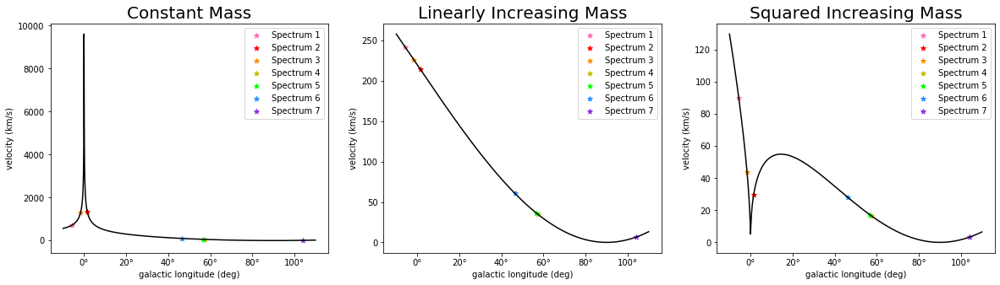

In [69]:
pl.figure(figsize=(20,5))
ax1 = pl.subplot(1,3,1)
pl.title('Constant Mass', fontsize='20')
ax1.plot(x, expected_constant, color='k')
ax1.scatter(glons[0], expected_vels_1[0], marker='*', color='hotpink', label='Spectrum 1')
ax1.scatter(glons[1], expected_vels_1[1], marker='*', color='r', label='Spectrum 2')
ax1.scatter(glons[2], expected_vels_1[2], marker='*', color='darkorange', label='Spectrum 3')
ax1.scatter(glons[3], expected_vels_1[3], marker='*', color='y', label='Spectrum 4')
ax1.scatter(glons[4], expected_vels_1[4], marker='*', color='lime', label='Spectrum 5')
ax1.scatter(glons[5], expected_vels_1[5], marker='*', color='dodgerblue', label='Spectrum 6')
ax1.scatter(glons[6], expected_vels_1[6], marker='*', color='blueviolet', label='Spectrum 7')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax1.legend()
ax2 = pl.subplot(1,3,2)
pl.title('Linearly Increasing Mass', fontsize='20')
ax2.plot(x, expected_linear, color='k')
ax2.scatter(glons[0], expected_vels_2[0], marker='*', color='hotpink', label='Spectrum 1')
ax2.scatter(glons[1], expected_vels_2[1], marker='*', color='r', label='Spectrum 2')
ax2.scatter(glons[2], expected_vels_2[2], marker='*', color='darkorange', label='Spectrum 3')
ax2.scatter(glons[3], expected_vels_2[3], marker='*', color='y', label='Spectrum 4')
ax2.scatter(glons[4], expected_vels_2[4], marker='*', color='lime', label='Spectrum 5')
ax2.scatter(glons[5], expected_vels_2[5], marker='*', color='dodgerblue', label='Spectrum 6')
ax2.scatter(glons[6], expected_vels_2[6], marker='*', color='blueviolet', label='Spectrum 7')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax2.legend()
ax3 = pl.subplot(1,3,3)
pl.title('Squared Increasing Mass', fontsize='20')
ax3.plot(x, expected_kepler, color='k')
ax3.scatter(glons[0], expected_vels_3[0], marker='*', color='hotpink', label='Spectrum 1')
ax3.scatter(glons[1], expected_vels_3[1], marker='*', color='r', label='Spectrum 2')
ax3.scatter(glons[2], expected_vels_3[2], marker='*', color='darkorange', label='Spectrum 3')
ax3.scatter(glons[3], expected_vels_3[3], marker='*', color='y', label='Spectrum 4')
ax3.scatter(glons[4], expected_vels_3[4], marker='*', color='lime', label='Spectrum 5')
ax3.scatter(glons[5], expected_vels_3[5], marker='*', color='dodgerblue', label='Spectrum 6')
ax3.scatter(glons[6], expected_vels_3[6], marker='*', color='blueviolet', label='Spectrum 7')
pl.xlabel('galactic longitude (deg)')
pl.ylabel('velocity (km/s)')
ax3.legend()

<a id="mass"></a>
## Predicted Mass
[Index](#Index)

We cannot calculate a predicted mass because the oberved velocities do not line up with any of the rotation curves.

<a id="tables"></a>
## Tables
[Index](#Index)

In [70]:
data_rows = []
for ii, meta in enumerate(used_data):
    temp_dict = {}
    temp_dict['filename'] = meta['filename']
    temp_dict['glon'] = meta['glon']*u.deg
    temp_dict['glat'] = meta['glat']*u.deg
    temp_dict['rvcorr'] = meta['rvcorr']
    temp_dict['topocentric velocity peak 1'] = topocentric[ii][0]
    temp_dict['topocentric velocity peak 2'] = topocentric[ii][1]
    temp_dict['barycentric velocity peak 1'] = barycentric[ii][0]
    temp_dict['barycentric velocity peak 2'] = barycentric[ii][1]
    temp_dict['LSR velocity peak 1'] = irs[ii][0]
    temp_dict['LSR velocity peak 2'] = irs[ii][1]
    temp_dict['velocity uncertainty'] = errors_v[ii]
    if len(irs[ii]) == 3:
        temp_dict['topocentric velocity peak 3'] = topocentric[ii][2]
        temp_dict['barycentric velocity peak 3'] = barycentric[ii][2]
        temp_dict['LSR velocity peak 3'] = irs[ii][2]
    
    data_rows.append(temp_dict)
    
table_results = Table(data_rows)
table_results

LSR velocity peak 1,LSR velocity peak 2,LSR velocity peak 3,barycentric velocity peak 1,barycentric velocity peak 2,barycentric velocity peak 3,filename,glat,glon,rvcorr,topocentric velocity peak 1,topocentric velocity peak 2,topocentric velocity peak 3,velocity uncertainty
object,object,object,object,object,object,str124,object,object,float64,object,object,object,object
-119.50131203748828 km / s,-239.22187599606235 km / s,-- km / s,-128.93128180149864 km / s,-248.65184576007275 km / s,-- km / s,.\final_data\brownnina\9_26\fits_files\science\psd_200926_155048_tint60s_sdr0_fswscience_moon.fits,-3.2523718886305173 deg,354.41969635194187 deg,-28756.109399814017,-100.17517240168463 km / s,-219.89573636025872 km / s,-- km / s,1.2906973766105068 km / s
-97.14107610051124 km / s,-176.0079660342434 km / s,-- km / s,-107.94918796923567 km / s,-186.81607790296783 km / s,-- km / s,.\final_data\ashneil\nash\9_20_drift\psd_200920_170803_tint60s_sdr0_fsw9_20_drift_60s.fits,-4.500303725889523 deg,1.4787124814234223 deg,-29495.540280816436,-78.45364768841922 km / s,-157.3205376221514 km / s,-- km / s,3.314014527369856 km / s
-97.54224236223675 km / s,-156.90770623427358 km / s,-- km / s,-108.3884355010889 km / s,-167.75389937312576 km / s,-- km / s,.\final_data\ashneil\nash\9_20_drift\psd_200921_163543_tint60s_sdr0_fsw9_20_drift_60s.fits,0.8202252870855566 deg,358.35250827061645 deg,-29417.17768569429,-78.97125781539462 km / s,-138.33672168743146 km / s,-- km / s,10.608784649448355 km / s
-91.67185784093132 km / s,-173.58463391261807 km / s,-- km / s,-107.75283008347613 km / s,-189.6656061551629 km / s,-- km / s,.\final_data\teixeirakatie\Katie Teixeira-Radio Astronomy Lab\science\psd_200922_211338_tint60s_sdr0_fswscience_target6.fits,-1.6406220578002948 deg,57.33223197351567 deg,-18942.49590735619,-88.81033417611994 km / s,-170.7231102478067 km / s,-- km / s,8.101192442070928 km / s
-92.09225748090951 km / s,-166.31648131924587 km / s,-- km / s,-108.3430763233538 km / s,-182.56730016169018 km / s,-- km / s,.\final_data\teixeirakatie\Katie Teixeira-Radio Astronomy Lab\science\psd_200922_210822_tint60s_sdr0_fswscience_target6.fits,-0.5672620945638208 deg,56.72323416361129 deg,-19180.68182333451,-89.16239450001929 km / s,-163.38661833835567 km / s,-- km / s,7.464342325816968 km / s
-89.51753215393762 km / s,-144.1555195419895 km / s,-- km / s,-106.01157431815824 km / s,-160.64956170621016 km / s,-- km / s,.\final_data\teixeirakatie\Katie Teixeira-Radio Astronomy Lab\science\psd_200922_205139_tint60s_sdr0_fswscience_target5.fits,-0.19208012655474735 deg,46.371760384355994 deg,-22944.23974033521,-83.06733457782302 km / s,-137.70532196587496 km / s,-- km / s,33.726105844470716 km / s
-119.50131203748828 km / s,-156.70872055296755 km / s,-205.68566028267318 km / s,-123.17453592282406 km / s,-166.4039311474473 km / s,-215.38087087715292 km / s,.\final_data\sparkeshannah\radio_astro_data\science\psd_200924_231413_tint60s_sdr0_fswscience_63_1.fits,4.547367777162395 deg,104.17456712794376 deg,3311.249392484054,-126.48578531530812 km / s,-169.71518053993137 km / s,-218.69212026963697 km / s,5.089705938165555 km / s
